In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
from gprofiler import GProfiler

import h5py
import collections
import scipy.sparse as sp_sparse
import tables
import logging

import anndata2ri
import rpy2.rinterface_lib.callbacks
import rpy2.robjects
from rpy2.robjects import pandas2ri
import diffxpy.api as de

In [2]:
sc.set_figure_params(scanpy=True, dpi=200)

In [3]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

sc.settings.verbosity = 4
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.1.0 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.7.1 louvain==0.6.1


In [4]:
%%R
# Load libraries from correct lib Paths for my environment - ignore this!
.libPaths(.libPaths()[c(3,2,1)])

# Load all the R libraries we will be using in the notebook
library(scran)
library(RColorBrewer)
library(slingshot)
library(monocle)
library(gam)
#library(clusterExperiment)
library(ggplot2)
library(plyr)
library(MAST)

Load in the data

In [5]:
adataa1 = sc.read_10x_h5('/Users/vyom/data/SB10_SB11_results/Individual_Samples/SB10/Beyaz_10_10xgex_araasco/filtered_feature_bc_matrix.h5', genome=None, gex_only=True)
adataa1.var_names_make_unique()

reading /Users/vyom/data/SB10_SB11_results/Individual_Samples/SB10/Beyaz_10_10xgex_araasco/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
adataa2 = sc.read_10x_h5('/Users/vyom/data/SB10_SB11_results/Individual_Samples/SB11/Beyaz_11_10xgex_arasco/filtered_feature_bc_matrix.h5', genome=None, gex_only=True)
adataa2.var_names_make_unique()

reading /Users/vyom/data/SB10_SB11_results/Individual_Samples/SB11/Beyaz_11_10xgex_arasco/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
adatac = sc.read_10x_h5("/Users/vyom/data/SB10_SB11_results/Individual_Samples/SB10/Beyaz_10_10xgex_control/filtered_feature_bc_matrix.h5", genome=None, gex_only=True)
adatac.var_names_make_unique()


reading /Users/vyom/data/SB10_SB11_results/Individual_Samples/SB10/Beyaz_10_10xgex_control/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [8]:
adatac1 = sc.read_10x_h5("/Users/vyom/data/SB10_SB11_results/Individual_Samples/SB11/Beyaz_11_10xgex_control/filtered_feature_bc_matrix.h5", genome=None, gex_only=True)
adatac1.var_names_make_unique()

reading /Users/vyom/data/SB10_SB11_results/Individual_Samples/SB11/Beyaz_11_10xgex_control/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
# merge datasets
adata1 = adatac.concatenate(adataa1, adatac1, adataa2,   batch_key='Sample', batch_categories=['Control10','Araasco10', 'Control11','Araasco11'])

In [10]:
adata1.obs['sample'] = " "
for i in range(len(adata1.obs)):
    if adata1.obs['Sample'][i] == 'Control10':
        adata1.obs['sample'][i] = "Control"
    elif adata1.obs['Sample'][i] == 'Araasco10':
        adata1.obs['sample'][i] = "Araasco"
    elif adata1.obs['Sample'][i] == 'Control11':
        adata1.obs['sample'][i] = "Control"
    elif adata1.obs['Sample'][i] == 'Araasco11':
        adata1.obs['sample'][i] = "Araasco"


<ipython-input-10-fd98f5e30b62>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['sample'][i] = "Control"
<ipython-input-10-fd98f5e30b62>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['sample'][i] = "Araasco"
<ipython-input-10-fd98f5e30b62>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['sample'][i] = "Control"
<ipython-input-10-fd98f5e30b62>:10: SettingWithCopyWarning: 
A value is trying to be set

In [11]:
adata1.obs

,Sample,sample
AAACCCACACCCTAAA-1-Control10,Control10,Control
AAACCCACAGTCACGC-1-Control10,Control10,Control
AAACCCAGTCTGCGCA-1-Control10,Control10,Control
AAACCCAGTGACAGCA-1-Control10,Control10,Control
AAACCCATCAAGTAAG-1-Control10,Control10,Control
...,...,...
TTTGTTGTCCACCTCA-1-Araasco11,Araasco11,Araasco
TTTGTTGTCCATCTAT-1-Araasco11,Araasco11,Araasco
TTTGTTGTCGGTCTGG-1-Araasco11,Araasco11,Araasco
TTTGTTGTCTAGATCG-1-Araasco11,Araasco11,Araasco


In [12]:
#Filter genes that are not expressed in many cells(threshold min: 5):
print('Total number of genes: {:d}'.format(adata1.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata1, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata1.n_vars))

Total number of genes: 32285
filtered out 16043 genes that are detected in less than 20 cells


/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Number of genes after cell filter: 16242


In [13]:
# Calculate normalized values for counts 
adata1.obs['n_counts'] = adata1.X.sum(1)
adata1.obs['log_counts'] = np.log(adata1.obs['n_counts'])
adata1.obs['n_genes'] = (adata1.X > 0).sum(1)

Identify number genes and counts and conduct log transformation of the counts

In [14]:
# filter cells that have produced less than 200 counts
sc.pp.filter_cells(adata1, min_counts=200)

### Define gene sets for QC metrics

Cell stress increases variability and introduces bias. As a result, it is necessary to account for cells that are high in stress as their trancriptome would vary significanly from the viable sample thus skewing results. The proportion of mitochrondrial and ribosomal counts are metrics for cell stress. Cells with an elevated proportion of mitochrondrial and ribosomal counts are exempt from the sample.

In [15]:
# define mitochondrial and ribosomal genes
mito_genes = [name for name in adata1.var_names if name.startswith('mt-')]
Rpl_genes = [name for name in adata1.var_names if name.startswith('Rpl')]
Rps_genes = [name for name in adata1.var_names if name.startswith('Rps')]
ribo_genes = Rpl_genes + Rps_genes
# for each cell compute fraction of counts in mito genes vs. all genes
# the ".A1" is only necessary, as X is sparse - it transform to a dense array after summing
adata1.obs['percent_mito'] = np.sum(
    adata1[:, mito_genes].X, axis=1) / np.sum(adata1.X, axis=1)
# add the total counts per cell as observations-annotation to adata
adata1.obs['n_counts'] = np.sum(adata1.X, axis=1)
#Count IEG genes and calculate percentage per cell
#adata.obs['percent_IEG'] = np.sum(
#    adata[:, IEG].X, axis=1) / np.sum(adata.X, axis=1)
#Calculate the percent Rpl genes per cell
adata1.obs['percent_Rpl'] = np.sum(
    adata1[:, Rpl_genes].X, axis=1) / np.sum(adata1.X, axis=1)
#Calculate the percent Ribo genes per cell
adata1.obs['percent_ribo'] = np.sum(
    adata1[:, ribo_genes].X, axis=1) / np.sum(adata1.X, axis=1)
#Calculate the percent cell cycle genes per cell
#adata.obs['percent_cell_cycle'] = np.sum(
#    adata[:, cell_cycle].X, axis=1) / np.sum(adata.X, axis=1)
#sc.tl.score_genes(adata,cell_cycle,score_name='cell_cycle')


# add the total counts per cell as observations-annotation to adata

/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


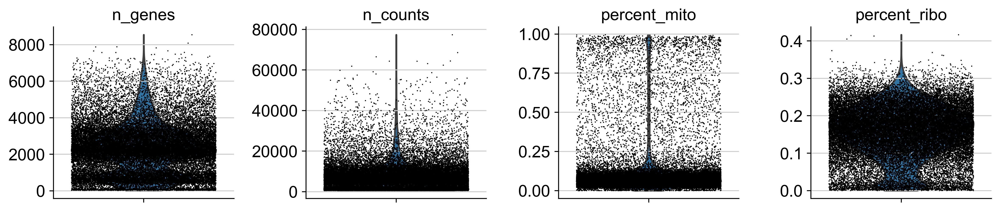

In [16]:
# identify proportions of stressed cells
axs = sc.pl.violin(adata1, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo'],
                   jitter=0.4, multi_panel=True)

/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


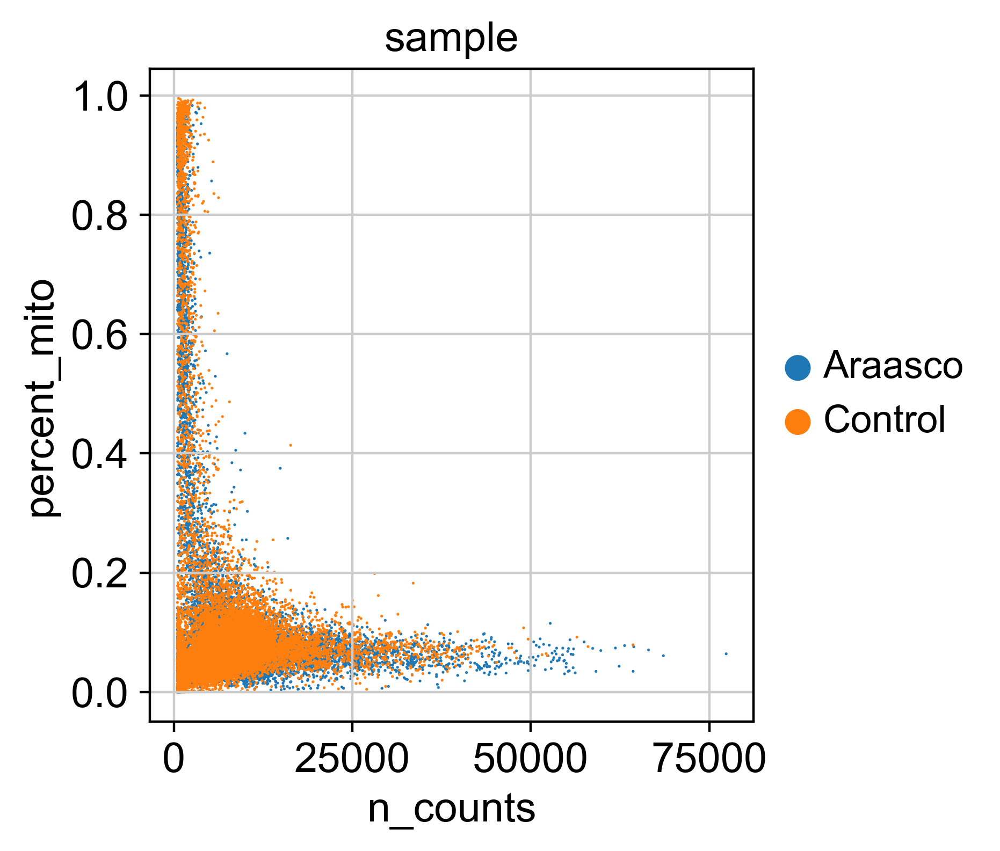

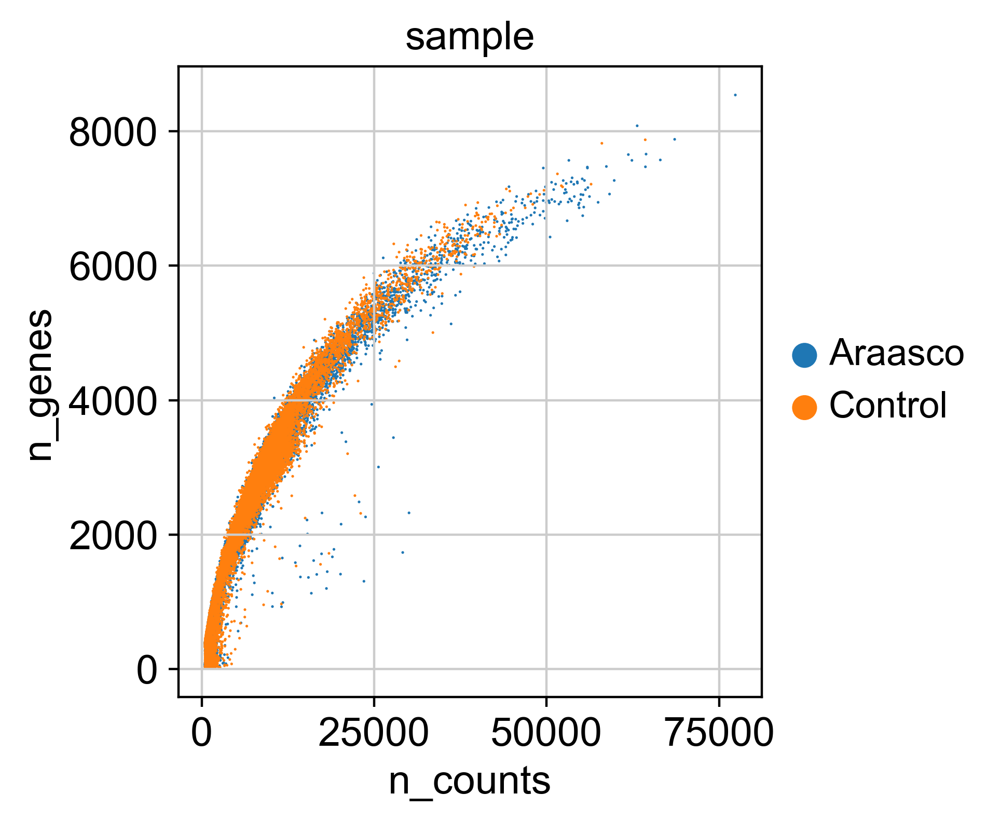

In [17]:
ax = sc.pl.scatter(adata1, x='n_counts', y='percent_mito', color='sample')
ax = sc.pl.scatter(adata1, x='n_counts', y='n_genes', color='sample')

In [18]:
# define cells to be exempt
n_gene_cap = 10000
n_counts_min = 4000
percent_mito_cap = 0.15

print("Cells with n_genes < " + str(n_gene_cap) + ":", len(adata1[adata1.obs['n_genes'] < n_gene_cap]))
print("Cells with n_genes > " + str(n_gene_cap) + ":", len(adata1[adata1.obs['n_genes'] > n_gene_cap]))
print()
print("Cells with n_counts_min < " + str(n_counts_min) + ":", len(adata1[adata1.obs['n_counts'] < n_counts_min]))
print("Cells with n_counts_min > " + str(n_counts_min) + ":", len(adata1[adata1.obs['n_counts'] > n_counts_min]))
print()
print("Cells with percent_mito < " + str(percent_mito_cap) + ":", len(adata1[adata1.obs['percent_mito'] < percent_mito_cap]))
print("Cells with percent_mito > " + str(percent_mito_cap) + ":", len(adata1[adata1.obs['percent_mito'] > percent_mito_cap]))

Cells with n_genes < 10000: 34161
Cells with n_genes > 10000: 0

Cells with n_counts_min < 4000: 10777
Cells with n_counts_min > 4000: 23382

Cells with percent_mito < 0.15: 29955
Cells with percent_mito > 0.15: 4206


/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(d

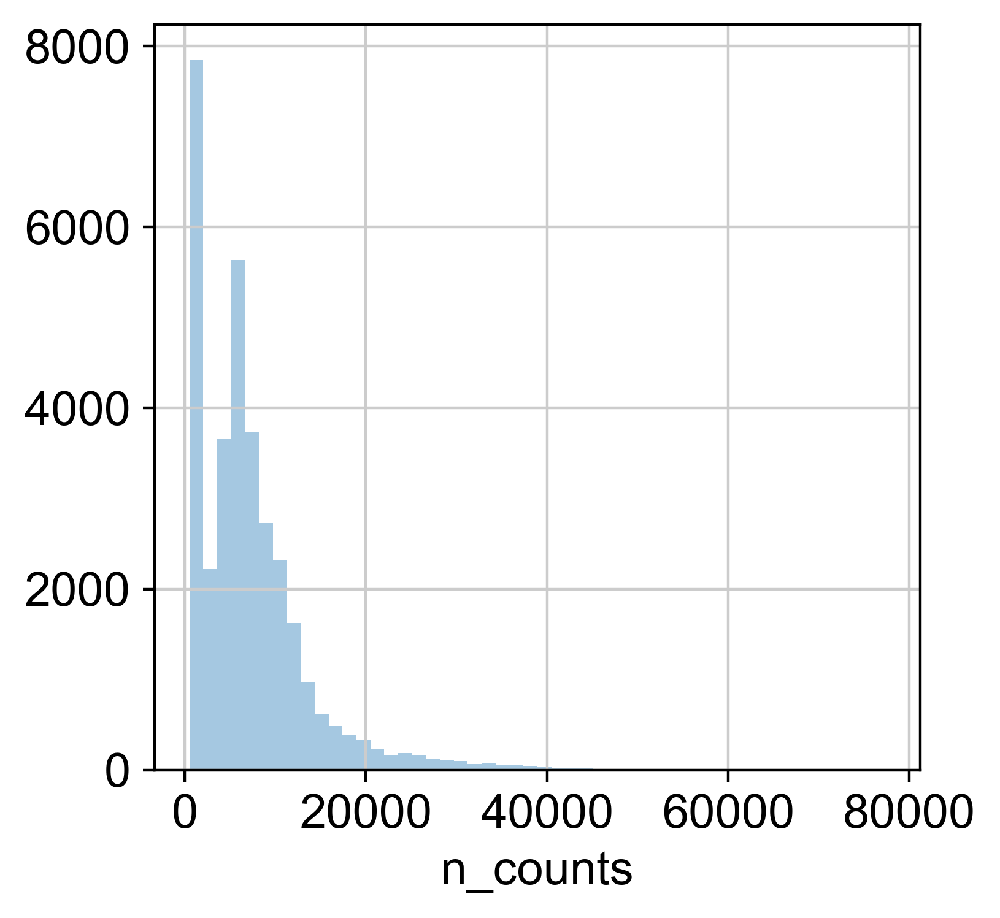

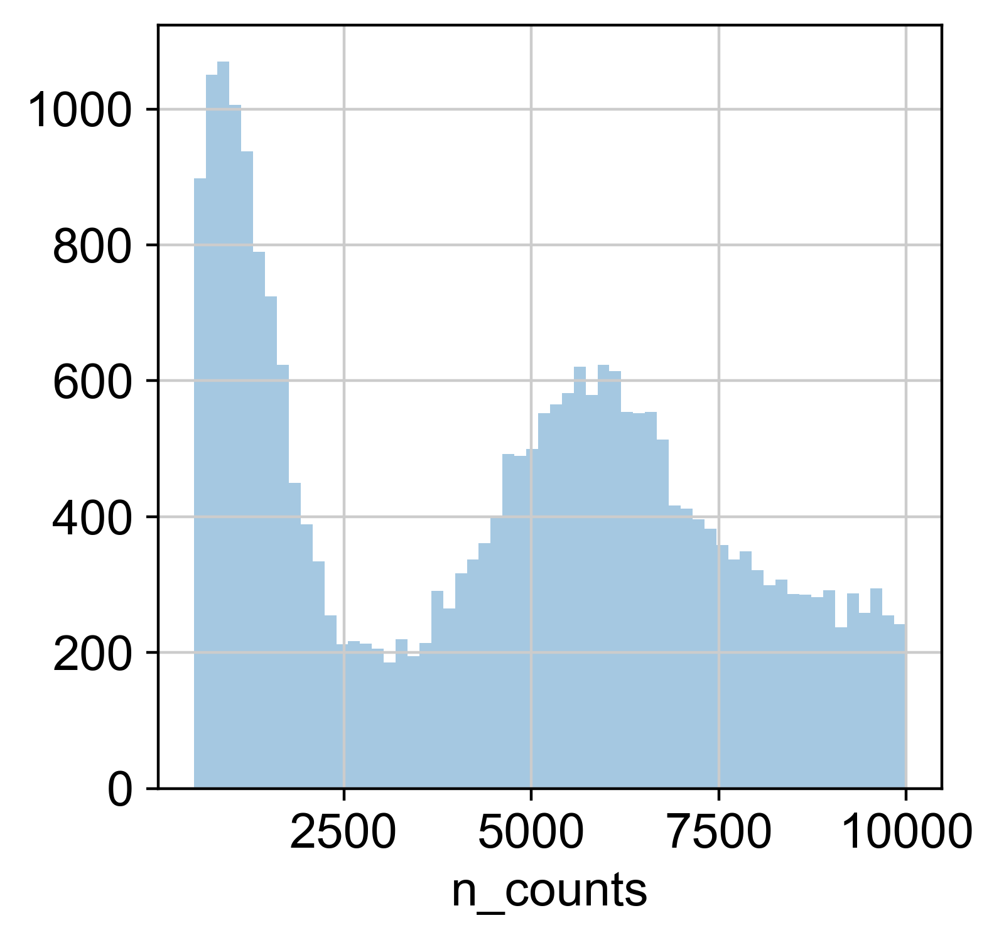

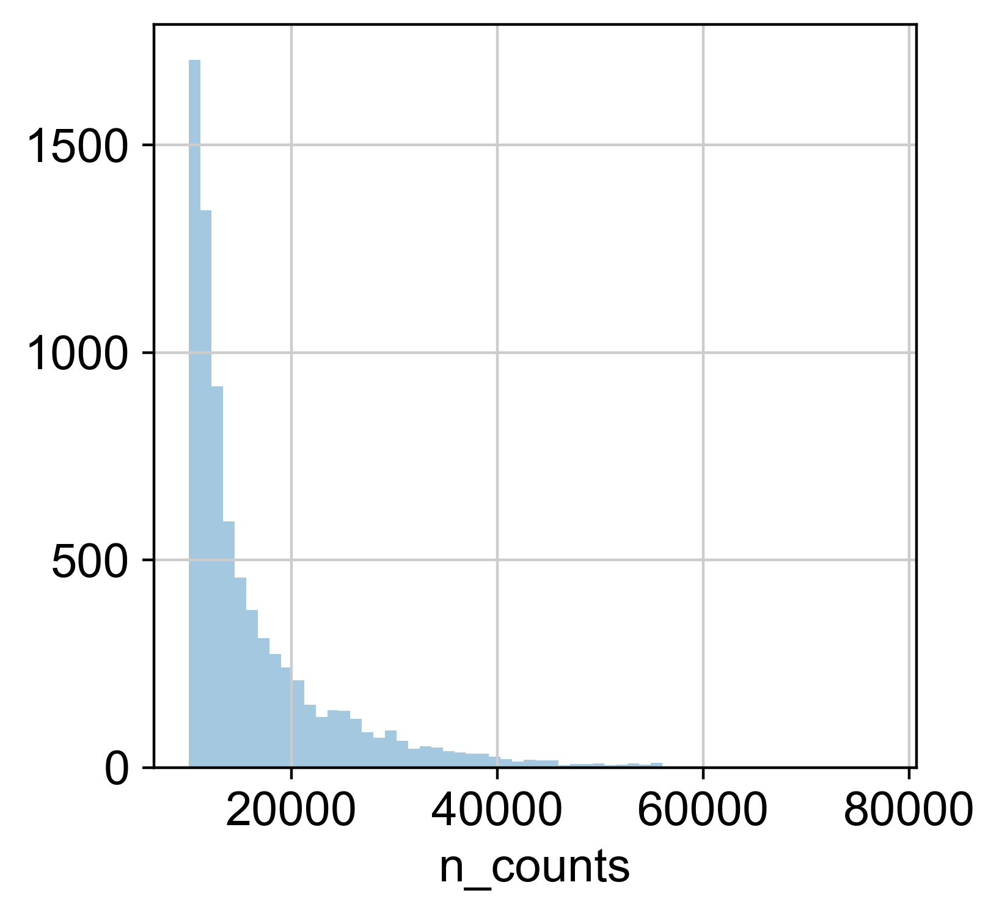

In [19]:
#Thresholding decision: counts
p3 = sb.distplot(adata1.obs['n_counts'], kde=False)
plt.show()

p4 = sb.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']<10000], kde=False, bins=60)
plt.show()

p5 = sb.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

In [20]:
# filter cell sample
print("Number of cells before filtering:",len(adata1))
adata1 = adata1[adata1.obs['n_genes'] < n_gene_cap, :]
adata1 = adata1[adata1.obs['percent_mito'] < percent_mito_cap, :]
adata1 = adata1[adata1.obs['n_counts'] > n_counts_min, :]
print("Number of cells after filtering:",len(adata1))

Number of cells before filtering: 34161
Number of cells after filtering: 22445


/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [21]:
# filter gene sample
print("Number of cells before filtering:",len(adata1))
#adata1 = adata1[adata1.obs['n_genes'] > 1000, :]
print("Number of cells after filtering:",len(adata1))

Number of cells before filtering: 22445
Number of cells after filtering: 22445


/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


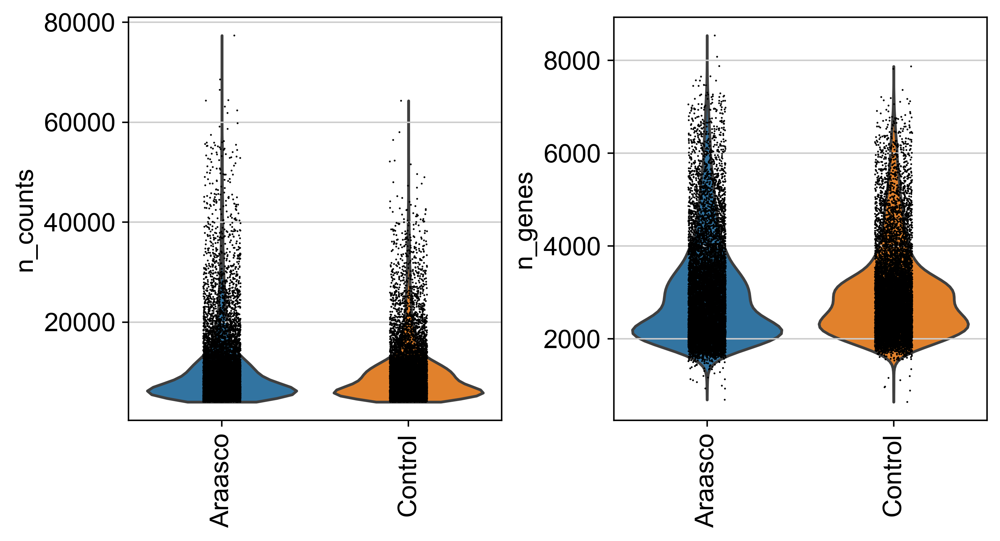

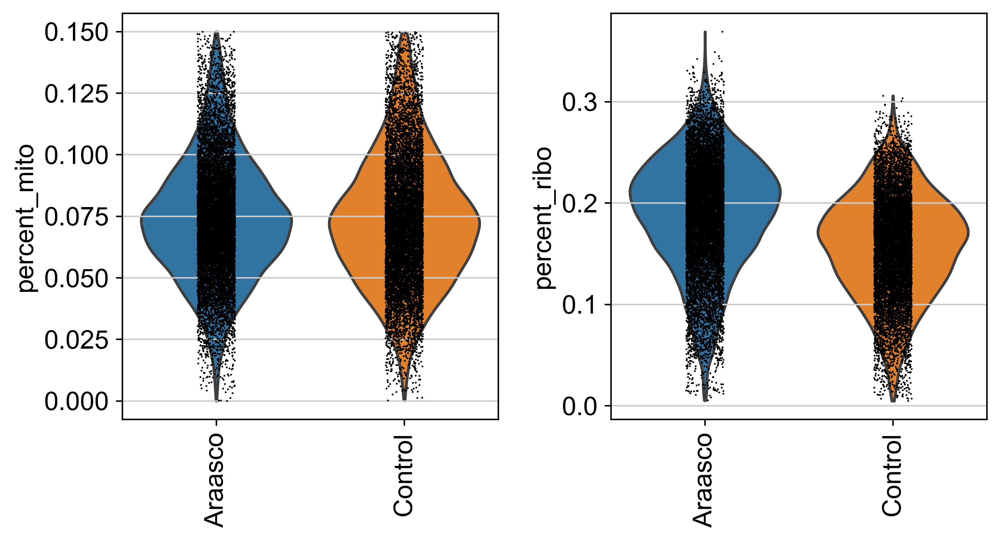

In [22]:
# view sample distributions to ensure filtering was accurate 
sc.pl.violin(adata1, groupby='sample', keys=['n_counts','n_genes'], rotation=90)
sc.pl.violin(adata1, groupby='sample', keys=['percent_mito','percent_ribo'], rotation=90)

In [23]:
# view dimensions of the annotated data matrix
adata1.shape

(22445, 16242)

GENE LEVEL ANALYSIS
calculate gene specific expression values to identify correlations

In [24]:
# define genes/gene sets for gene level analysis
marker_genes = dict()
# single genes
marker_genes['S'] = ['S100a6']
marker_genes['T'] = ['Fabp1']
marker_genes['X'] = ['Ctnnb1']
marker_genes['B'] = ['Apc']
marker_genes['V'] = ['Scd1']
marker_genes['K'] = ['Myc']
marker_genes['l'] = ['Lgr5']
marker_genes['l'] = ['Lgr5']
marker_genes['h'] = ['Hopx']
marker_genes['si'] = ['Siah1a']
marker_genes['A'] = ['Id2']
marker_genes['covid'] = ['Ace2']

marker_genes['x'] = ['Abcb1', 'Adam10','Alex1','Ascl2','Axin2','Bambi','Bcl2l2','Bcl2l1','Birc5','Bmi1','Bmp4','Ccnd1','Cd44','Cdkn2a','Cdx1','Cldn1','Cox2','Cox1','Dkk1','Dkk4','Dnmt1','Edn1','Efnb1','Enc1','Ephb2','Ephb3','Fgf18','Fgfbp1','Fgfbp3','Fra1','Fscn1','Gast','Hath','Nedd9','Hes1','Id2','Tcf4','Jag1','Jun','L1cam','Lamc2','Lef1','Lgr5','Mena','Met','Mmp14','Mmp7','Myb','Myc','Mycbp','Nos2','Notch2','Nrcam','Plaur','Ppard','S100a4','Sgk1','Smc3','Sox9','Sp5','Srsf3','Suz12','Tcf1','Tiam1','Tnc','Vegf','Yap1','Ccnd3','Fzd1','Fz7','Btrcp','Ctnnb1','Nemo','Naked','Rnf43','Lrp6','Lrp5','Olfm4','Prex1','Rac1','Cldn15','Edn3','Efnb2','Ephb4','Fgfr4','Nedd8','Tcf7','Jag2','Smc2','Zeb1','Zeb2','S100a6','Cdh2','Cdh1','Actb','Gapdh']
marker_genes['y'] = [ 'Adam10','Ascl2','Bambi','Bcl2l2','Bcl2l1','Birc5','Bmi1','Ccnd1','Cd44','Cdx1','Dnmt1','Edn1','Efnb1','Enc1','Ephb2','Ephb3','Fgfbp1','Nedd9','Hes1','Id2','Tcf4','Jun','L1cam','Lamc2','Lgr5','Met','Mmp14','Mmp7','Myb','Myc','Mycbp','Plaur','Ppard','Smc3','Sox9','Sp5','Srsf3','Suz12','Tiam1','Yap1','Ccnd3','Ctnnb1','Rnf43','Lrp6','Lrp5','Olfm4','Rac1','Cldn15','Efnb2','Ephb4','Nedd8','Tcf7','Smc2','S100a6','Cdh1','Actb','Gapdh']

# 90 somthing ß Catenin target Genes from HFD paper
marker_genes['BCT_adjusted2'] = [ 'Adam10','Ascl2','Bambi','Bcl2l2','Bcl2l1','Birc5','Bmi1','Ccnd1','Cd44','Cdx1','Dnmt1','Edn1','Enc1','Ephb2','Ephb3','Fgfbp1','Nedd9','Hes1','Id2','Lamc2','Met','Mmp14','Mmp7','Myb','Myc','Plaur','Ppard','Smc3','Sp5','Srsf3','Suz12','Tiam1','Yap1','Ccnd3','Ctnnb1','Rnf43','Lrp6','Lrp5','Olfm4','Rac1','Cldn15','Fabp1','S100a6','Efnb2','Ephb4','Tcf7','Smc2','S100a6','Cdh1','Actb']
# custom gene sets 
marker_genes['test'] = ['Hopx']
marker_genes['ex'] = ['Efnb1','Tcf4','Jun','L1cam','Lgr5','Mycbp','Sox9','Nedd8','Gapdh']
marker_genes['CSC'] = ['Cd24','Cd133','Cd44','Cd29','Cd90','Esa','Aldh1']
marker_genes['Wnt'] = ['Lgr5', 'Rnf43', 'Lrp6', 'Axin1', 'Apc', 'Gsk3b', 'Ctnnb1', 'Tcf7l2',  'Fbxw7']
marker_genes['diff'] = ['Bmp1','Smad7','Bmp2','Bmp5','Bmp7','Bmpr2']
marker_genes['Wnt1'] = ['Lgr5', 'Rnf43', 'Ctnnb1','Ccnd1','Id2', 'Ephb2', 'Olfm4', 'Slc12a2','Ascl2', 'Ephb2', 'Cldn4','Rnf11', 'Rnf186','Acaa2','Hmgcs2'   ]
marker_genes['bcat'] = ['Lgr5', 'Rnf43', 'Ctnnb1','Ccnd1','Id2', 'Ephb2', 'Olfm4', 'Slc12a2','Ascl2', "Hopx",'Ephb2', 'Cldn4','Id2'   ]
marker_genes['stem'] = ['Id2']
c19 = ['Ace2', 'Trpc1','Tmprss2','Stat1','Stat2','Cxcl10','Irf3','Tnf']#'Cxcl10','Irf3','Il8','Il6','Tnf'
BC_targets = [ 'Fabp1','S100a6','Adam10','Ascl2','Bambi','Bcl2l2','Bcl2l1','Birc5','Bmi1','Ccnd1','Cd44','Cdx1','Dnmt1','Edn1','Enc1','Ephb2','Ephb3','Fgfbp1','Nedd9','Hes1','Id2','Lamc2','Met','Mmp14','Mmp7','Myb','Myc','Plaur','Ppard','Smc3','Sp5','Srsf3','Suz12','Tiam1','Yap1','Ccnd3','Ctnnb1','Rnf43','Lrp6','Lrp5','Olfm4','Rac1','Cldn15','Efnb2','Ephb4','Tcf7','Smc2','S100a6','Cdh1','Actb']

In [25]:
marker_genes['yap'] = [
'C87977',
'Ces1h',
'Cd83',
'Reg3a',
'G6pc',
'Olfm4',
'Car4',
'Ces1d',
'Gkn3',
'Cyp3a25',
'Akr1c14',
'Hmgcs2',
'Bbox1',
'Slc28a1',
'Hsd17b6',
'Agr3',
'Paqr9',
'Ces1f',
'Fabp1',
'Siglec15',
'Slc6a3',
'Ccl9',
'Mt4',
'Pcp4l1',
'Rims4',
'Slc5a11',
'Leap2',
'Cyp2d26',
'Ttr',
'Ctrb1',
'Edn2',
'Pcdh8',
'Ky',
'Cyp2u1',
'Slc5a4b',
'Gm17367',
'Mt2',
'Tsga10ip',
'Pla2g10',
'Fbp1',
'Apoa2',
'Prelp',
'Ttc39c',
'1810046K07Rik',
'Rbp7',
'Vwce',
'Slc5a4a',
'Ces1b',
'Gm9992',
'4933417A18Rik',
'Aqp8',
'Adh6-ps1',
'Spp2',
'Treh',
'Dnase1',
'Cd244',
'Slc13a1',
'Slc2a5',
'Ramp1',
'Sardh',
'Adh6b',
'Vwa1',
'Slc30a2',
'Ugt2b37',
'Serpina1b',
'Cyp2c40',
'Akr1b7',
'Gm684',
'Slc37a2',
'4933402N03Rik',
'Ano7',
'Ces1e',
'Arg2',
'Duox2',
'Upk3b',
'Akr1c6',
'Ces1g',
'Fabp6',
'Rasd2',
'Ggt1',
'Neurog3',
'Cst6',
'Gm17269',
'Rgn',
'Ugt2b5',
'Nox1',
'Cyp2c38',
'Rdh7',
'Guca1a',
'Rec8',
'Trim38',
'Pla2g5',
'Eci3',
'Reg1',
'Hpgds',
'Tpsg1',
'Gstm2-ps1',
'Mfsd7a',
'Pbld1',
'Slc2a10',
'1190002H23Rik',
'Gstm1',
'Capn9',
'Mme',
'Gm11078',
'Ostb',
'Kit',
'Gm6020',
'Gstm3',
'Fer1l6',
'Slc25a45',
'Acaa1b',
'Abp1',
'Cyp2c69',
'Ugt2b38',
'Slc2a7',
'Id4',
'Odf3b',
'Lipn',
'Tnfsf10',
'Vwa2',
'Mosc1',
'Spink3',
'Ces2a',
'Ido1',
'N4bp2l1',
'Wnt3',
'Slco2b1',
'Spdef',
'Slc26a3',
'Gpr157',
'Akr1c20',
'D630039A03Rik',
'Scn2b',
'Ces2b',
'Aqp4',
'Cyp2e1',
'Rasl12',
'Lgr5',
'Creb3l1',
'Prrx1',
'Creb3l4',
'Akr1c21',
'Slc30a10',
'Cyp2c68',
'Atoh1',
'Iyd',
'Rhbg',
'Bco2',
'Enpp7',
'Pros1',
'Pnliprp1',
'Cyp3a11',
'Mcf2l',
'Adh1',
'Slc16a12',
'Gpr155',
'Slc47a1',
'Epb4.2',
'Ern2',
'Abcc6',
'Ugt2b36',
'Ltb4r1',
'Cml1',
'Rac2',
'R3hdml',
'Proz',
'Ltb4r2',
'Otop3',
'Cyp3a59',
'Efcab4b',
'Agr2',
'Pthlh',
'Tmem86a',
'Crp',
'Gm10935',
'9530053A07Rik',
'Abca1',
'Muc2',
'Sis',
'Gstm6',
'Pdcd4',
'Cd302',
'Ccdc3',
'Fcgbp',
'St3gal4',
'Pigr',
'Slc10a5',
'Neu3',
'Nr0b2',
'Car8',
'Gm14295',
'Tert',
'Acsm5',
'Ypel2',
'Dhrs3',
'Ffar2',
'4930430O22Rik',
'Gpr133',
'Ces1c',
'Slc6a19',
'Cyp2c67',
'Slc13a2',
'Abcb9',
'Cyp4f15',
'Sord',
'2010001E11Rik',
'Aldob',
'Slc12a8',
'Khk',
'Slc5a1',
'Bace2',
'Amigo2',
'Kbtbd11',
'Kctd14',
'Slc7a15',
'Rep15',
'Slit2',
'Amica1',
'Dio1',
'2810408A11Rik',
'Adh4',
'Cox7a1',
'Gm10925',
'Usp2',
'5330417C22Rik',
'Scgn',
'Dll4',
'Sp5',
'Tfpi2',
'Atp2c2',
'Ces2e',
'1300002K09Rik',
'Prss30',
'Fmo1',
'Zg16',
'Msi1',
'Gm10684',
'Mep1a',
'Lct',
'Gm10109',
'Tox',
'Hemgn',
'Fam46c',
'Slc43a2',
'Rassf4',
'Mcoln2',
'Vim',
'Syce3',
'Slc27a6',
'Mro',
'Ttc36',
'Slc22a1',
'Adh6a',
'Rbp2',
'Hepacam2',
'Ndufa4l2',
'Pbld2',
'Cyp2c39',
'Slc6a20a',
'Hes2',
'Akr1c19',
'Bmp3',
'Duoxa2',
'Slc2a2',
'Gm52',
'Tcea3',
'Nav2',
'Retnlb',
'Mt1',
'Fev',
'Gamt',
'Ccl25',
'Fabp2',
'Faah',
'Pla2g4a',
'Fam117a',
'Sema4c',
'Ucn3',
'Cd177',
'Pcdh19',
'Pipox',
'Trpa1',
'Rasa4',
'Dpyd',
'Rap1gap',
'Galnt5',
'Adcy8',
'2410017I17Rik',
'Mogat2',
'Slc7a8',
'mt-Atp6',
'Gm11437',
'Gstm4',
'Ociad2',
'Sorcs2',
'Slc4a5',
'Sectm1b',
'Dbp',
'Ptpro',
'Hsd11b2',
'Card11',
'Hpn',
'Maob',
'Gstm7',
'Csad',
'Bcas1',
'Gm12258',
'Tex12',
'Nr2e3',
'Ncald',
'Slc5a8',
'Mical1',
'Cbs',
'Naaladl1',
'Fzd4',
'Scin',
'Tead2',
'1810030J14Rik',
'Agmat',
'Lrrc19',
'Kcnj2',
'Gng11',
'Ptprn2',
'Selm',
'Mpp3',
'Esam',
'Ces2f',
'Cd200',
'Tac1',
'Slc6a4',
'Fbln1',
'Dak',
'Papss2',
'Lmcd1',
'Ttyh3',
'Mgst1',
'Gcg',
'Cyp2d22',
'Slc28a3',
'Dpep1',
'Sema7a',
'Gm609',
'Lfng',
'Vwa5b2',
'Il17rd',
'Gltpd2',
'Psmb8',
'Apoa4',
'Slc14a1',
'Lcp1',
'Agmo',
'Oat',
'Slc2a9',
'Palm',
'Noxa1',
'Slc39a5',
'Lrat',
'Asah2',
'Aqp1',
'Sidt1',
'Cyp2b9',
'Ccl6',
'Apoc3',
'Kcnk16',
'Cplx2',
'Fam151a',
'Gpt',
'Spink4',
'Bambi',
'Pm20d1',
'Gm1123',
'Cd36',
'Cyp2b13',
'9130204L05Rik',
'Klk1',
'Ang4',
'Rimbp2',
'Rassf5',
'Vdr',
'Sbk1',
'Klhl24',
'Nts',
'Comp',
'Apoc2',
'Slc16a10',
'Lrig3',
'Sox4',
'Aldh1b1',
'Mertk',
'Efna4',
'Casp6',
'Fgf1',
'Adrbk2',
'Pde2a',
'Defa3',
'Acot1',
'Ccr9',
'Acy1',
'Bche',
'Slc46a3',
'Gm7030',
'Gm11062',
'Rnase4',
'2010106E10Rik',
'Adck3',
'Mreg',
'Btnl3',
'Abat',
'Hcn3',
'Neurl2',
'Tmem45b',
'Tmsb15b2',
'Slc41a2',
'Nlrc3',
'1810020D17Rik',
'Atp5l',
'Sfrp5',
'Dmbt1',
'Tmsb15b1',
'Akr1c13',
'Wnk2',
'Nat8',
'Ces2d-ps',
'Gm9851',
'Ugt2a3',
'Fmo5',
'Prss12',
'Slc37a4',
'Adra2a',
'Sox4',
'Lrmp',
'B3galt5',
'BC057022',
'Glyctk',
'Unc5cl',
'Rgmb',
'Mfsd7b',
'Plbd1',
'Fahd1',
'Tff3',
'Cps1',
'Kifc2',
'Pdzd3',
'Pon3',
'Ephx1',
'Aldoc',
'Serpinf2',
'Fam19a3',
'Ang',
'2210404O07Rik',
'Ces2c',
'Slc1a1',
'Gm13318',
'Tmsb15l',
'2010007H06Rik',
'Arl4d',
'Apol10a',
'Gm766',
'Slc17a1',
'Gm11992',
'G0s2',
'1700019G17Rik',
'1500009L16Rik',
'E130116L18Rik',
'Vav3',
'Gpd1',
'Tpd52l1',
'Acot11',
'Otc',
'Rab27a',
'Ces2h',
'Plod2',
'Sema6d',
'H2afv',
'Map2k6',
'Vipr1',
'Fmo4',
'Mlxipl',
'Cyp4f13',
'2310016G11Rik',
'Dmpk',
'Tm4sf5',
'Mpz',
'Sval1',
'Tmie',
'Aqp11',
'Gdpd1',
'BC089597',
'Cytip',
'Pycard',
'Tcn2',
'Thrb',
'Pik3r5',
'S100g',
'Rab15',
'Gm11074',
'Galnt12',
'2010107G12Rik',
'Slc9a3',
'Rragd',
'Nav1',
'Fam53b',
'Atp2a3',
'Rgs2',
'Gfra3',
'Acss1',
'Sectm1a',
'Ppp1r1b',
'Cyp2b10',
'Sphk1',
'Ckb',
'Gramd1a',
'Fxyd3',
'Mnx1',
'Afp',
'Rnf144b',
'Ghr',
'Per3',
'Hagh',
'Acpp',
'Nrarp',
'Gstm2',
'Axin2',
'Mycl1',
'H2-Q2',
'Glt1d1',
'Gdpd5',
'Acot4',
'E030010A14Rik',
'Bcmo1',
'H2-T3',
'Cttnbp2',
'Shf',
'Abcg8',
'Itpka',
'Reg3b',
'Bfsp1',
'D18Ertd653e',
'Pde9a',
'Gm7866',
'Acp5',
'Mgst2',
'Fcgrt',
'Itln1',
'AW112010',
'Gcnt4',
'Cat',
'Ace',
'Lyz2',
'Kif12',
'Defa-rs1',
'Ehhadh',
'Gm17635',
'Slc17a4',
'Hacl1',
'Ugt1a7c',
'Hpd',
'Npl',
'Dpp4',
'Sytl1',
'Ptpn22',
'Arrdc2',
'Irf8',
'Defa-rs7',
'Hadh',
'Gip',
'Cldn15',
'Rnf152',
'Dnajc28',
'Ugt1a6a',
'Gpr22',
'Foxa3',
'Gimap5',
'Smoc2',
'Pklr',
'Dnajb3',
'Habp2',
'G630090E17Rik',
'Ugt1a1',
'Slc27a2',
'Ugt1a5',
'Ugt1a2',
'1200009I06Rik',
'Cfi',
'Ugt1a10',
'Ugt1a9',
'Ugt1a6b',
'Gm7092',
'Slc6a7',
'Lrp1',
'Foxa2',
'Scarb1',
'Tef',
'Gm9847',
'Sypl2',
'Ugt1a8',
'Efr3b',
'Prlr',
'Ctse',
'Hnf4g',
'Osbpl6',
'Bex4',
'Sytl2',
'Cndp1',
'Car9',
'Capn8',
'Trp53i11',
'Cfp',
'Trim72',
'Mex3a',
'1810049H13Rik',
'Igfbp4',
'Gm10104',
'Engase',
'Hsd17b13',
'Omt2b',
'Btnl7',
'Ralgps1',
'Ankrd37',
'Chchd7',
'Gm11353',
'E030011O05Rik',
'Pou2f3',
'Myb',
'Prap1',
'Tlr1',
'Pink1',
'Noxo1',
'Cbr1',
'Nipsnap1',
'4931406C07Rik',
'Txndc16',
'Gm15292',
'Rad51l1',
'Cyp4f14',
'Fgl2',
'Cnnm1',
'Hopx',
'Depdc1b',
'A2ld1',
'A930039A15Rik',
'Vav1',
'Hyi',
'mt-Atp8',
'Gm11016',
'Serinc3',
'8430419L09Rik',
'Zfp808',
'Aldh1a1',
'Hook1',
'Clca3',
'Syt13',
'Cd24a',
'Atp8a2',
'2210407C18Rik',
'Glrx',
'Defa17',
'Lmx1a',
'C4bp',
'Zfp704',
'Gm6696',
'Prodh2',
'Gm8074',
'Ms4a12',
'St3gal3',
'Ell3',
'Gm5549',
'Apobec2',
'Slc18a2',
'Hdhd3',
'Ly75',
'Aldh1a7',
'Tspan1',
'Galnt11',
'Camk2n1',
'Cda',
'Dach1',
'Lgi4',
'Ephx2',
'Smarca2',
'Sec14l2',
'Aadac',
'1700024P16Rik',
'Amn',
'Zdhhc14',
'Rtn4rl1',
'Phf21b',
'Abcd1',
'Gpr128',
'Slc35e3',
'Cyp2c29',
'Nags',
'Fam40b',
'Lrp4',
'Btnl2',
'Scml4',
'Slc25a42',
'Efna3',
'Gm15299',
'Kcnq1',
'Greb1',
'9030617O03Rik',
'Clps',
'Tmem205',
'Cyp4f40',
'Ascl2',
'Ndrg1',
'AI464131',
'Tstd1',
'Tmprss4',
'Tifa',
'Macrod1',
'9130409I23Rik',
'Lhpp',
'Gpx2',
'Sult1d1',
'Nkx2-2',
'Gprin3',
'Ddc',
'Scp2',
'Dhrs4',
'Bend7',
'Reg3g',
'Akr1c12',
'Plekho2',
'Prpsap1',
'Tnfsf13',
'Slc25a35',
'Add3',
'Angpt2',
'Srl',
'Cyb5',
'Gm10260',
'Insm1',
'Phyh',
'Tbc1d8',
'1810014F10Rik',
'Nr1h3',
'Rcn1',
'Guca2b',
'Lyz1',
'Ccrl1',
'Kcne3',
'Hunk',
'Slc3a1',
'Cc2d2a',
'Rorc',
'Plac8',
'Sesn1',
'Kcnf1',
'Cep72',
'Retsat',
'3930402G23Rik',
'Rab43',
'Nqo1',
'Ebpl',
'Galnt7',
'Cela1',
'Rangrf',
'Chek2',
'Gramd3',
'Lyve1',
'Tmem37',
'Dnahc8',
'Mboat2',
'Fam117b',
'Ces2g',
'Slc12a2',
'Gm8973',
'1110020G09Rik',
'Bst1',
'Mafb',
'Ffar3',
'Cyp4f16',
'Tmem117',
'2610008E11Rik',
'Gstt1',
'Nr1i3',
'Slc23a1',
'Tph1',
'Marcks',
'Cdca7',
'Pfkfb4',
'Slc25a15',
'Sipa1l2',
'Psmb9',
'Steap3',
'5033414D02Rik',
'Defa24',
'Ddhd2',
'Ccl25',
'Tmod4',
'Fam158a',
'Acer1',
'Acaa2',
'Acad11',
'Gpr56',
'D630013G24Rik',
'Thnsl2',
'Rcor2',
'Slc36a1',
'Sec16b',
'Smpd2',
'Mosc2',
'BC096441',
'2810459M11Rik',
'1700019D03Rik',
'Ace2',
'Cldn2',
'1110031I02Rik',
'Lrp2bp',
'Slc16a3',
'Gm15284',
'Mttp',
'Tspan13',
'Pyroxd2',
'Ifitm3',
'Isoc1',
'Tnfsf13b',
'Prosapip1',
'Esrrg',
'Zfp606',
'Socs2',
'Creb3l3',
'Rilp',
'Gm7849',
'Sh2d6',
'Hexb',
'Acpl2',
'Gm15315',
'Galm',
'Defa5',
'Lass6',
'2010011I20Rik',
'Mmd',
'Dnajc12',
'Dll1',
'Dnajb13',
'Tnfsf12',
'Aldh9a1',
'Pdia2',
'1700040L02Rik',
'Atp1a1',
'1110003O08Rik',
'Slc27a1',
'Ephb3',
'Zc3h12d',
'Arsg',
'Ypel3',
'Ppara',
'Rasa3',
'Tmco4',
'0610039K10Rik',
'D3Ertd751e',
'Pik3r3',
'Pdss1',
'Glb1',
'Appl2',
'Klkb1',
'Sepp1',
'Sykb',
'Siae',
'Ppm1j',
'Efna1',
'Muc4',
'Gnpda1',
'5730469M10Rik',
'Gal3st2',
'Gm9705',
'Rab3d',
'Cml5',
'Hdac11',
'Azi1',
'D930015E06Rik',
'Clec2e',
'4933422H20Rik',
'Fam132a',
'Pfkm',
'Papln',
'B4galnt4',
'Gjb1',
'Mxd4',
'1600014C10Rik',
'Slc15a1',
'Bnip3',
'Gchfr',
'Cyb5r3',
'Slc25a34',
'Cox7c',
'Ugt2b35',
'Ccnb1ip1',
'Fcamr',
'Pdk2',
'Abcb1b',
'Cited4',
'Tex9',
'Tmed6',
'Far2',
'Insl6',
'Ankle1',
'Slc25a23',
'Akr7a5',
'Narf',
'Rnase1',
'Isoc2a',
'BC049352',
'Pkdcc',
'Bmp7',
'Shpk',
'Hes6',
'1110002B05Rik',
'Mctp2',
'Defa25',
'Hdac5',
'Pvrl1',
'1700025G04Rik',
'Tnik',
'Cyp4v3',
'Slc34a2',
'Vkorc1',
'Clec2d',
'Smpd3',
'Fam13a',
'Pla2g2f',
'Cpn1',
'Plxnb1',
'Mid1',
'Tm7sf2',
'Tgfbi',
'Defa26',
'Epb4.1l3',
'Abcg5',
'Exph5',
'Gm9222',
'Ctss',
'Fam109a',
'Zfp362',
'Zfp41',
'2210415F13Rik',
'Gucy2c',
'Unc93b1',
'Pank3',
'Tmem59',
'Gpr35',
'Tspan3',
'Tex9',
'Notch1',
'Synpo',
'Celf3',
'Cd74',
'Pdk1',
'3110057O12Rik',
'Gm10029',
'Btd',
'Zfp810',
'Marcksl1',
'Etv4',
'Arrdc3',
'2200002J24Rik',
'Gdpd2',
'Rnf186',
'Slc35f2',
'Rnf32',
'Zfp799',
'Gm885',
'Gm15308',
'Mgat3',
'Arhgap9',
'E330009J07Rik',
'Pxmp4',
'9530008L14Rik',
'Fam78a',
'Extl1',
'Mtch2',
'2810432L12Rik',
'Clic6',
'Xkr5',
'Naprt1',
'Nrg4',
'Lipg',
'Pcnx',
'Alox5ap',
'Hmx3',
'Atpif1',
'Ugdh',
'Vegfc',
'Arg1',
'Mdh1',
'Etv5',
'Gm17553',
'Qdpr',
'Zhx3',
'Nr5a2',
'Pisd',
'Slfn9',
'Ksr1',
'Ccrl1',
'Mocs1',
'Plch1',
'Gm6665',
'Chga',
'Tmtc4',
'Acaa1a',
'Fmnl2',
'Ankrd22',
'Gm6570',
'Tmem132a',
'Gsta3',
'Fth1',
'Tc2n',
'Tmem64',
'Hsd17b4',
'AI118078',
'H2-Q2',
'Fam73b',
'Camk4',
'Chdh',
'Khdrbs3',
'4632404H12Rik',
'Tmem8',
'Nrtn',
'Zfp932',
'P2ry6',
'Gpr30',
'Cd59a',
'Rasgrp4',
'Casp1',
'Nmral1',
'Pygl',
'Decr1',
'Cdx1',
'Fzd9',
'Atp6v0e2',
'Zfp629',
'1700066B19Rik',
'Rps28',
'Ephb4',
'Tmem163',
'Gm10768',
'Cbx7',
'Atp8a1',
'Dnm1',
'Gm5113',
'Klhl17',
'Gm11048',
'Hck',
'Sdsl',
'Fabp5',
'Gm14850',
'Gm15293',
'Tiam1',
'Fsd1l',
'Grb7',
'Nit2',
'Spib',
'Cyp2j6',
'Tox3',
'Abhd14a',
'Trim2',
'Bhlha15',
'Napepld',
'Fas',
'Tfrc',
'Nlrc4',
'Gm9994',
'Inpp5j',
'Fgfrl1',
'Urod',
'Mtx3',
'Tbc1d14',
'Gm10967',
'Zfand1',
'Lrrc26',
'Slc25a36',
'Stx17',
'Rccd1',
'Snx20',
'Cyp2c44',
'Mmp7',
'Tmem89',
'AY761184',
'Tymp',
'Aplp1',
'Gimap1',
'Fahd2a',
'Cyp2c66',
'Tha1',
'Casp3',
'Cdca7l',
'Ms4a10',
'Tnfrsf11a',
'Lpgat1',
'Upb1',
'Ak4',
'Scg2',
'Chgb',
'Btg2',
'Brp44',
'Ggt7',
'2900097C17Rik',
'Lgals2',
'Zkscan14',
'Pnkd',
'Msra',
'Ocm',
'Itgam',
'Dcxr',
'Alg6',
'Atf7ip',
'Ppt1',
'Insig1',
'Pcmtd2',
'Ccdc28a',
'Slc35a3',
'Nudt12',
'Acrbp',
'Slx1b',
'Phlpp2',
'Ero1lb',
'Dppa5b',
'Tcf7',
'Ulk1',
'Cyp2c65',
'Mast3',
'Tmem42',
'Golt1a',
'Fut8',
'Il11ra1',
'Aldh18a1',
'Ifi30',
'Acad12',
'Cebpa',
'Reep6',
'Jakmip1',
'Cdc73',
'Zbtb38',
'Slc7a9',
'Stmn1',
'Bcl2',
'Clybl',
'Zfp873',
'Deptor',
'Gde1',
'Atp10b',
'Nrgn',
'Prps2',
'Fuca1',
'Ephb2',
'Gramd1c',
'Alcam',
'Tnfrsf19',
'1110021L09Rik',
'St3gal1',
'Armcx1',
'Tppp',
'Foxo4',
'Rnf43',
'BC066135',
'Gm9780',
'Gm10395',
'Gm2104',
'Gla',
'Gsta1',
'Wbp1',
'Slc30a1',
'Rpa3',
'Nr1d2',
'Trpm5',
'AI467606',
'Entpd8',
'Upp1',
'Txndc5',
'D130043K22Rik',
'Aldh3a2',
'Ccbl1',
'Mdm1',
'4831426I19Rik',
'Dhrs11',
'Tec',
'Golm1',
'Neil3',
'9130230L23Rik',
'Fchsd2',
'Usp49',
'Vti1b',
'Defa20',
'Gm14410',
'Ampd3',
'Slc7a4',
'Cenpp',
'Xkr9',
'Cuedc1',
'Rcbtb1',
'Baiap2l2',
'Wipi1',
'Lrrc56',
'Nr3c2',
'Gm239',
'Ccnjl',
'Arsb',
'Bcl11b',
'Slc16a13',
'Gatsl2',
'Ambp',
'Gpam',
'Morn2',
'Tcf4',
'Trak1',
'Bcl7a',
'Uqcrh',
'Lclat1',
'Uqcr11',
'D14Ertd449e',
'Map4k2',
'Idh1',
'Ttc23',
'Siglec5',
'Bcl2l15',
'Scd1',
'Dhrs1',
'Bpgm',
'Tbc1d4',
'Fam183b',
'Dgat1',
'Chrm3',
'Cbx8',
'Stap2',
'Rgs13',
'Yipf1',
'Neto2',
'Pcp2',
'Abcc2',
'Bet1',
'Pde3a',
'Fam98c',
'Rabgap1l',
'Hist2h2be',
'Syde2',
'Sesn3',
'Cyp2j9',
'1500035N22Rik',
'Agt',
'Cep68',
'Scrn2',
'Rad54b',
'Matn2',
'Gm7861',
'Cox7a2',
'Atp7b',
'Rnf167',
'Fermt1',
'Ern1',
'Arhgef26',
'Tomm40l',
'Tmem97',
'Fbxl20',
'Polg2',
'Grk5',
'Phldb1',
'C8g',
'Dhcr7',
'Fbxo48',
'Anxa13',
'2610021A01Rik',
'Glcci1',
'Sh3bgrl',
'Slc12a7',
'Gpld1',
'Scamp1',
'Ube2cbp',
'Prss41',
'Dgat2',
'Hist1h2bc',
'Cphx',
'Cox7b',
'1110001J03Rik',
'Heatr7b1',
'Klhdc9',
'Dab1',
'Cd38',
'Gm10311',
'A930001N09Rik',
'Pik3r1',
'Osgepl1',
'Kdsr',
'Mansc1',
'Matk',
'Gm10639',
'Gcdh',
'Sh2d7',
'Gm10108',
'Barx2',
'Atp6ap2',
'Mlec',
'Gm3776',
'Ehf',
'Slc22a4',
'Zfp759',
'Acsl1',
'Il17rb',
'1110034G24Rik',
'Cftr',
'Fam115c',
'Psmb10',
'Mpzl1',
'Wee1',
'Zfp125',
'Sema4g',
'Npc1l1',
'Btn3a3',
'Slc27a4',
'Ano9',
'D4Wsu53e',
'Myl6b',
'Bpnt1',
'Ms4a8a',
'1810046J19Rik',
'Plekhf1',
'Pgbd1',
'Gmds',
'Bcl11a',
'Mterfd3',
'Alox5',
'Guca2a',
'Apcdd1',
'Cmc1',
'Zfp950',
'Mettl7a1',
'Tmem19',
'Pex1',
'Hddc2',
'Nme3',
'Prepl',
'Lpin1',
'Gm1840',
'Vps13d',
'Man1a',
'1700029I15Rik',
'Aqp3',
'Uxt',
'Pcsk1',
'Abcb1a',
'Slc16a6',
'Sdhd',
'Shmt1',
'Slc25a44',
'Fads2',
'Fam123b',
'Abhd14b',
'Zfp101',
'Zfp273',
'Tnfaip8l1',
'Tmem20',
'Defa22',
'Gstt3',
'Pkig',
'Slc9a5',
'Gm7889',
'Cxxc5',
'Tiparp',
'Oit1',
'Rxra',
'Ndst1',
'Bckdha',
'Abl1',
'Mrpl34',
'Prkag2',
'D2hgdh',
'Sycp3',
'Zfp768',
'Ctsa',
'Entpd7',
'Amacr',
'Psme2b-ps',
'Pter',
'5031425E22Rik',
'Gcat',
'Ifitm2',
'Lpar5',
'Glb1l',
'Cep78',
'Ttc39a',
'Asph',
'Klhl8',
'H2-Q10',
'Ptplad1',
'Dyrk1b',
'Atp1b1',
'BC017158',
'Ahcy',
'Fryl',
'Ptgr1',
'Nnt',
'B2m',
'Pgam2',
'Brca2',
'Soat1',
'Pif1',
'Plcb3',
'Sdhb',
'Cyp2c55',
'Ntpcr',
'4430402I18Rik',
'Lmnb2',
'Slc39a14',
'Lipt2',
'Arhgap39',
'Plcg1',
'Kdelc2',
'Glo1',
'Myo5c',
'Whrn',
'Mavs',
'Glul',
'1110017F19Rik',
'Hsd17b11',
'Cdc42ep4',
'Nr3c1',
'Tpmt',
'Mkks',
'Ivns1abp',
'Glb1',
'Rundc3a',
'Rhebl1',
'Zswim7',
'Smo',
'Itfg3',
'Sypl',
'Zfp157',
'Herc2',
'Celsr2',
'Pms1',
'Cox6c',
'Creg1',
'Casp7',
'Snph',
'AI462493',
'Ceacam20',
'Chic1',
'Reg4',
'2010107H07Rik',
'Polr3gl',
'Plac9',
'Etv6',
'Tap2',
'Zfp358',
'Gm6104',
'Nfkbid',
'Me2',
'Dbi',
'Rnf145',
'Ptgs1',
'Paip2',
'Mrps33',
'Lrig1',
'Grhpr',
'Gm9961',
'Rbak',
'Ttc30b',
'AI428936',
'Eci1',
'Timeless',
'Dpysl2',
'Xylb',
'Cybasc3',
'Tmem141',
'Ctso',
'Ndufb10',
'Rps3a',
'Mthfs',
'Mtfmt',
'Rab19',
'Tst',
'Sfxn1',
'Fam199x',
'Ece1',
'Ccl5',
'Cep70',
'Ispd',
'Trim32',
'Zfp93',
'Nfe2',
'Accn2',
'Gm14851',
'Acvr2b',
'Atp5g3',
'Vps37d',
'Gpi1',
'Pdxk',
'Plch2',
'Oaf',
'Samhd1',
'Kcnk6',
'Prss32',
'Gm10979',
'Dao',
'Slc26a6',
'H2afj',
'Cdh24',
'Them4',
'Izumo4',
'Zfp942',
'Tnfaip8l2',
'1190007I07Rik',
'Chpt1',
'Mgst3',
'Chd6',
'Syce2',
'Hes1',
'Cnnm2',
'Galk1',
'Erbb3',
'4930420K17Rik',
'Gm17413',
'1700034H15Rik',
'Gpsm2',
'Ift140',
'Dock8',
'Tmem176a',
'4931414P19Rik',
'1810012P15Rik',
'Auh',
'Glmn',
'Hmgb3',
'4933403F05Rik',
'Atat1',
'Cd320',
'AK157302',
'Dna2',
'Hddc3',
'Rpl30',
'Ndufa1',
'Pycrl',
'Ncapd3',
'Gm15800',
'Ndufb5',
'mt-Nd3',
'Maged1',
'Tcfap4',
'Tmem25',
'Ndufa6',
'Ndufb2',
'Rmnd1',
'BC030870',
'Slc41a1',
'Extl2',
'Gls',
'Rab4a',
'Cacna1d',
'4930427A07Rik',
'Apoo',
'Mpnd',
'Zfp459',
'Ccdc88c',
'Tmem206',
'Kctd2',
'Zfp58',
'Gp1bb',
'Inpp5b',
'Gm4535',
'Tfdp2',
'Polr3k',
'Cdkn2c',
'Sar1b',
'Rab7l1',
'Mcee',
'Fam136b-ps',
'Plekhg6',
'1110038D17Rik',
'Gpr34',
'Tbc1d16',
'Ndufs2',
'Pld1',
'Zfp2',
'Tcf19',
'39695',
'Aldh16a1',
'Ccdc101',
'Ntn4',
'Aldh1l1',
'Ugt2b34',
'Rdh11',
'2810417H13Rik',
'2010300C02Rik',
'Bmx',
'Fbp2',
'Tonsl',
'Man2b1',
'Erap1',
'Epm2aip1',
'Atp5c1',
'2010107E04Rik',
'Dpysl5',
'Fbxo8',
'Tprkb',
'Gm16253',
'AI427809',
'Ing4',
'Slc19a2',
'Tsc22d3',
'Cbx2',
'Fam82b',
'Hectd3',
'Zfp866',
'Mfsd6l',
'Mtfp1',
'Sec22c',
'Pigx',
'Pgap3',
'Zfp944',
'Ndufa4',
'Galk2',
'Pcyox1',
'Mpst',
'Ndufc1',
'Gstk1',
'Ccdc28b',
'Ror2',
'Uqcr10',
'2610029I01Rik',
'Hexim1',
'Selenbp1',
'Clca4',
'Gstp1',
'D10Jhu81e',
'Zc3h8',
'Scg5',
'Gm10247',
'Gm3604',
'Mxi1',
'Lace1',
'4932443L11Rik',
'Kif15',
'Cox7a2l',
'Zfp192',
'Lphn2',
'Crat',
'Rdh5',
'Ap4m1',
'1700001L05Rik',
'Arrdc4',
'Fam63b',
'Igsf8',
'Clic5',
'Tmem135',
'Tnfrsf18',
'Epha1',
'Timm9',
'Ncapd2',
'Nptx2',
'Defa21',
'Gsto1',
'Atp5sl',
'Mrpl49',
'Prdx2',
'Zfp715',
'Golph3l',
'Gm7367',
'Pttg1',
'Cyb5b',
'Acat1',
'Cog5',
'Kif21b',
'Galnt4',
'Gm10257',
'Higd2a',
'Aldh3b1',
'Gsta2',
'Abcb10',
'Idh2',
'Hap1',
'Zfp54',
'Cyp27a1',
'Mecr',
'Atp5k',
'Ghrl',
'Thap2',
'Sort1',
'Baz2b',
'Pde7a',
'Oip5',
'Slc35b2',
'Cachd1',
'Mns1',
'Krt10',
'Ublcp1',
'Tm7sf3',
'Asb13',
'Ccdc34',
'Acbd4',
'Sap18',
'Gm10495',
'Tmem147',
'C330006D17Rik',
'Ccnj',
'Nqo2',
'Nadsyn1',
'Coq3',
'4732418C07Rik',
'Slc35c2',
'Cnp',
'Txlng',
'Hrsp12',
'Zfyve1',
'Npc2',
'Atp5j2',
'Acy3',
'Cela2a',
'Cenpk',
'Atp13a2',
'4632433K11Rik',
'Fam20a',
'Zbtb5',
'BC021891',
'Tmem81',
'Aig1',
'Fhod1',
'Zfp707',
'Tnrc6b',
'Clip2',
'Tecpr1',
'Mapk1ip1',
'Eml4',
'Zfp60',
'Dnajc22',
'Gm15821',
'Cideb',
'Gadd45g',
'Zfp955a',
'1700029G01Rik',
'Cfb',
'Gm10197',
'Lgr4',
'Bcl2l11',
'Zfp523',
'1700021C14Rik',
'Pgm2',
'Sst',
'Tbccd1',
'Osbpl7',
'Snn',
'Nfia',
'Bdh2',
'D430020J02Rik',
'Pemt',
'Mtcp1',
'B3galtl',
'Fancd2',
'1500010J02Rik',
'Ppm1h',
'Neurod1',
'Tssk6',
'Atpaf1',
'Gpr125',
'Pigp',
'Zfp113',
'2310047B19Rik',
'Csrnp2',
'Mastl',
'Mcm8',
'Zfp688',
'Mmab',
'Cpped1',
'Vamp1',
'Tnnt1',
'Pcmtd1',
'Trit1',
'Itpr1',
'Ly6g6c',
'C2',
'Nrbp2',
'Gja5',
'Cd81',
'Gls2',
'Lrrc8b',
'Ddit4l',
'P4hb',
'Tepp',
'Rnaset2a',
'Kdm3a',
'Deb1',
'Atm',
'C430048L16Rik',
'Nubpl',
'Stard7',
'Wipf1',
'Gigyf1',
'Atp6v0a2',
'Ahcyl2',
'Abhd6',
'Rfc3',
'Sec11c',
'Agpat3',
'Gnb1l',
'Dhfr',
'Slc25a28',
'St6galnac2',
'Rab3a',
'Dtl',
'Trpm4',
'Nfkbia',
'Gm10355',
'Sdhc',
'Syt7',
'Usp28',
'Elmod3',
'Zfp780b',
'Agk',
'Gstt2',
'Mdp1',
'Nusap1',
'Gm16314',
'Mrps36-ps1',
'Cyp2d34',
'Inpp4a',
'Apobec3',
'Acot13',
'Slc4a4',
'Casp9',
'2210012G02Rik',
'Sox13',
'Lipe',
'Pdpr',
'Ndrg3',
'Ifngr2',
'Gpc4',
'Bcl2l14',
'Hexdc',
'Pkn3',
'Mtcp1',
'C330019G07Rik',
'Gm5436',
'Gm17299',
'Nudt19',
'Zkscan1',
'3010026O09Rik',
'Thoc7',
'Zfyve21',
'Rapgef5',
'1700084C01Rik',
'Nop10',
'E130208F15Rik',
'Btbd3',
'Wdr76',
'Pyy',
'Ccdc72',
'Gm17680',
'1600002K03Rik',
'Mus81',
'Tmem22',
'Ak2',
'1110008L16Rik',
'Taldo1',
'Ndufs8',
'Tmem176b',
'Nmnat3',
'Kiss1',
'Hmgb1',
'3300002A11Rik',
'Kif24',
'Bloc1s1',
'Cds1',
'Pllp',
'1600021P15Rik',
'A430033K04Rik',
'Hmga2',
'Psrc1',
'Abtb1',
'Rpl9-ps4',
'Maf1',
'5830403L16Rik',
'Pik3r2',
'9830147E19Rik',
'Slco4a1',
'Masp2',
'Tspan14',
'Itpripl1',
'Mapk13',
'Usp3',
'Grk6',
'Psme2',
'Smap2',
'Apoe',
'Gstp2',
'Anpep',
'Fktn',
'Gtl3',
'Zfp825',
'Pnpla6',
'Ppcs',
'Pcyt2',
'Xrcc6bp1',
'Phospho2',
'Nr1i2',
'BC035947',
'Zfp661',
'Hif1a',
'Rps6ka6',
'Mgat4a',
'1700003E16Rik',
'Pcsk4',
'9430038I01Rik',
'G2e3',
'Mmaa',
'Nxt2',
'Tfam',
'Snrnp25',
'Nrn1',
'Ppargc1b',
'Mylk',
'Tgoln1',
'F630110N24Rik',
'Fam114a1',
'Gpbp1l1',
'1810022K09Rik',
'E130306D19Rik',
'Slc29a1',
'Sla2',
'Nuf2',
'Ccs',
'8430406I07Rik',
'Gm6728',
'Lenep',
'Twf1',
'Mzt2',
'Gstz1',
'Zfp956',
'2010111I01Rik',
'Atxn7l2',
'Cd247',
'Zfp12',
'Mrpl42',
'Phxr2',
'Ndufab1',
'Trim65',
'Trim14',
'Atp5o',
'Gpr82',
'C230081A13Rik',
'Ppp1r16a',
'Gga2',
'Nod1',
'Glg1',
'2010110P09Rik',
'Gm5475',
'Clcc1',
'Ndufs7',
'Kcnc3',
'Sgsm3',
'Zfp617',
'Dcaf11',
'Stk38l',
'Dgkd',
'Pepd',
'Sephs2',
'Ss18l1',
'0610011F06Rik',
'Aldh5a1',
'4930534B04Rik',
'Pde8a',
'Clec2h',
'Cpe',
'Clca2',
'Zadh2',
'Entpd6',
'Alg5',
'Cdca5',
'Zfp36l2',
'Hgfac',
'Tmem27',
'Maged2',
'Rpa2',
'Suclg1',
'Apoo-ps',
'Cenpw',
'Abr',
'Tm4sf20',
'Bri3bp',
'Gpatch2',
'Pik3c3',
'Dyx1c1',
'Fars2',
'Rbm38',
'Defa23',
'Mknk2',
'Bag4',
'Rfx3',
'Etfb',
'Sema6b',
'Ppp1r12b',
'Eef2k',
'Ttc30a1',
'Gpaa1',
'Ergic3',
'Pdk3',
'Gorasp1',
'Vrk3',
'Irf2bp1',
'Gramd1b',
'Pex10',
'Zfp260',
'Zfp738',
'Prdx4',
'Tia1',
'Zfp120',
'Sepx1',
'Rab20',
'Cybrd1',
'Zfp169',
'Chchd8',
'2410015M20Rik',
'Serinc4',
'1110059E24Rik',
'Tmem149',
'Prkdc',
'Klhdc5',
'Utrn',
'Pmm2',
'Eps8l3',
'Hpca',
'Crocc',
'Angptl4',
'Slc5a2',
'Acvr1b',
'Lap3',
'Fam100b',
'Dgcr6',
'Tm6sf2',
'Naip6',
'Slc2a8',
'Tmem186',
'Uqcrfs1',
'Ptprn',
'Zhx2',
'Ak3',
'Gm3511',
'Stxbp1',
'Mdh2',
'Txndc15',
'Man2a1',
'Acox3',
'Pgrmc2',
'B3gnt7',
'0910001L09Rik',
'Pcca',
'Spice1',
'Rnf215',
'Tecr',
'Erlec1',
'Snx7',
'Msh6',
'Epn1',
'Dcaf8',
'Dusp28',
'Nudt22',
'Zfp763',
'Gm5901',
'Foxred1',
'Tatdn3',
'Gk5',
'Lmbr1l',
'Usp45',
'Stk38',
'Fan1',
'Slc1a3',
'Amd2',
'Slc11a2',
'Ccpg1',
'Nudt7',
'Acox1',
'Clcn2',
'Lima1',
'Pnpo',
'Rpl3',
'Jtb',
'Cycs',
'Jag1',
'Rdh14',
'1700034H14Rik',
'Zfp292',
'Pex11a',
'Krtcap3',
'Ceacam2',
'Ttk',
'2310067B10Rik',
'Cars2',
'Dcbld1',
'1810027O10Rik',
'Pglyrp1',
'Rnf5',
'Prdm16',
'Lgals1',
'1500001M20Rik',
'Echdc2',
'Nipa2',
'Mapk9',
'Ogfod2',
'Slc44a3',
'Anxa4',
'Hmgn5',
'Slc31a1',
'Sgpp2',
'Phkb',
'Ndrg2',
'Lrdd',
'Sox12',
'Kctd15',
'Gm1818',
'Cox8a',
'Lamp2',
'Ankrd46',
'Ppa2',
'Pus3',
'Pdxp',
'Ndufs5',
'Zscan30',
'Cit',
'Arsa',
'Sox9',
'Tpk1',
'1110005A03Rik',
'1110059G10Rik',
'Atp5j',
'Neurl1b',
'Tinag',
'Senp8',
'Ndufv2',
'H2-D1',
'Zfp266',
'Gyltl1b',
'Impdh2',
'2510046G10Rik',
'Ano10',
'Tmem229b',
'Atox1',
'Rpl39',
'Tcfeb',
'AI314976',
'Rnasek',
'Lnx1',
'Ndufv1',
'Zfp955b',
'Tshz1',
'Pbxip1',
'Mms22l',
'Fam195a',
'Ccbl2',
'Zfp191',
'G6pc3',
'Tcirg1',
'Snx29',
'Tmem82',
'Rhoq',
'Sdhaf1',
'Exo1',
'Iqsec2',
'Ube2e3',
'Ptprg',
'Ttc38',
'Msh2',
'Rbl2',
'Ctns',
'Dars2',
'Zfp637',
'Dap',
'A1cf',
'Tysnd1',
'Zfp760',
'Egln3',
'Nphp3',
'Dgcr2',
'Dcps',
'Megf9',
'1190002N15Rik',
'Slc30a5',
'Zfp953',
'Ddt',
'Fdx1',
'Zfp607',
'Bcas3',
'Tcf3',
'Gm10250',
'Fam83f',
'Mcfd2',
'Adck2',
'Hbp1',
'Dennd3',
'C2cd3',
'Tbc1d13',
'Gm9776',
'Mul1',
'2310004I24Rik',
'Fam36a',
'Zkscan3',
'Spns2',
'Ceacam18',
'1810006K21Rik',
'Cpt2',
'A630055G03Rik',
'Gdf9',
'Rfc4',
'Il17rc',
'Ank',
'Chml',
'Ogt',
'Dpm3',
'Pigc',
'Mrps36',
'B4galt5',
'6430550D23Rik',
'Etaa1',
'Slc25a37',
'Dock1',
'C85492',
'Mrpl27',
'Mmachc',
'Cradd',
'Coq9',
'Cant1',
'Tmem63a',
'Arl6ip1',
'Uck2',
'Pank1',
'Resp18',
'Prodh',
'Rwdd2b',
'Ltc4s',
'Tmem161b',
'Pnliprp2',
'Fgfr2',
'Dusp23',
'Bad',
'Itgb3bp',
'Nat15',
'Mob3c',
'Slco3a1',
'Tnf',
'Stard10',
'Atp5e',
'Gabre',
'Ccdc39',
'Btg1',
'Fzd8',
'Gstm5',
'Cox6b1',
'Dlg3',
'Timm8b',
'Fbxl22',
'Zfpm1',
'Gm17498',
'2410018M08Rik',
'Lzic',
'Grcc10',
'Cd68',
'Zfp871',
'Isoc2b',
'Akr1e1',
'Pccb',
'Zfp239',
'Rmnd5a',
'Mcm10',
'Rnf149',
'Ppapdc2',
'Wdr13',
'Ndufv3',
'Pbx2',
'Klf7',
'Spag5',
'Tubal3',
'2310003L22Rik',
'Ppargc1a',
'Zfp213',
'Zfp369',
'6330403L08Rik',
'Ccdc51',
'Palb2',
'Dctpp1',
'Man1a2',
'Hdac6',
'Gm3054',
'Abhd3',
'Coasy',
'Dhrs7',
'Aco2',
'Wnk4',
'BC016495',
'Tmem220',
'Ndufb3',
'Txn1',
'Ddrgk1',
'Gm17484',
'Med22',
'Lyrm1',
'Fads1',
'Acp6',
'Timm17b',
'Lrrc45',
'Heatr5a',
'AU040320',
'D16H22S680E',
'Cgref1',
'Zcchc14',
'Evl',
'Pcbd2',
'Apoa1bp',
'Etfdh',
'Cenpv',
'Sigirr',
'Esrra',
'Nsun4',
'Tsen15',
'Fam54a',
'Soat2',
'Tmem208',
'Ppdpf',
'Dgkz',
'6030446N20Rik',
'Nr1d1',
'Wdyhv1',
'Mrps35',
'Hmg20b',
'Clstn1',
'Cep110',
'Etohi1',
'Zfp119a',
'Gtf2i',
'L2hgdh',
'Tdp2',
'Sct',
'Plcl2',
'Gm17349',
'Zfp422',
'Patz1',
'Fam122b',
'Cdk2',
'Asnsd1',
'Cdk4',
'Tomm7',
'1810030N24Rik',
'Mbtd1',
'Gm11273',
'Lypla1',
'Rnf135',
'Ndufb8',
'1110028C15Rik',
'Gsg2',
'Ndufaf4',
'Mat2b',
'Ckmt1',
'Tbc1d22b',
'Trappc1',
'Lage3',
'Cox4i1',
'Lime1',
'Zfp933',
'Adck5',
'Sucla2',
'Pex19',
'Cdr2',
'Asf1a',
'Plk1s1',
'Fastkd1',
'Atg10',
'1810063B05Rik',
'Stard3',
'Scd4',
'Tfb2m',
'Ccdc138',
'Diexf',
'Thra',
'Sgk1',
'Qsox2',
'Mast4',
'Fyco1',
'Sco1',
'Atxn3',
'Mccc2',
'Zmym3',
'Cyc1',
'Rfx7',
'Fbxl6',
'Zfp943',
'Pex5',
'Gm9846',
'Car12',
'Glod5',
'Lpcat3',
'Fanca',
'S100a5',
'Hcn2',
'Irf1',
'Mbd4',
'Pds5b',
'Bcap31',
'Aspg',
'Ccdc84',
'Ube2i',
'Pik3cg',
'Ttf2',
'Ssbp4',
'H2-Ke6',
'Acss2',
'Rg9mtd3',
'Med20',
'Slc25a11',
'Ndufb8',
'Ceacam1',
'Gcap14',
'G430095P16Rik',
'Dnajc9',
'Aco1',
'Ube2t',
'Cep250',
'Brip1',
'Hip1r',
'Copz1',
'Mlf1ip',
'Blvra',
'Dtwd2',
'Nt5dc2',
'Gm10642',
'Lrrc61',
'Foxp1',
'Tor1a',
'Cabp7',
'Golim4',
'Fam174b',
'Ppip5k1',
'4732471J01Rik',
'Ddi2',
'F2rl2',
'A730061H03Rik',
'Acadsb',
'Pnrc1',
'Txn2',
'Hexa',
'Rassf6',
'Arl4a',
'Osr2',
'Enpep',
'Coro7',
'Esco2',
'Enpp5',
'Prom1',
'Prcp',
'Gfpt1',
'Hmbs',
'Pdss2',
'Gm5160',
'9930021J03Rik',
'Lcmt1',
'Ripk2',
'Nuak2',
'Zfp119b',
'Hyls1',
'Lcorl',
'Smad5',
'1110008F13Rik',
'Gng13',
'BC030867',
'Gne',
'Pde5a',
'Psme1',
'A830073O21Rik',
'Spg7',
'1110008J03Rik',
'Hebp2',
'Ssr4',
'Ecsit',
'Sgpl1',
'Nsun4',
'Zmat5',
'2700049A03Rik',
'Homez',
'Mrps21',
'Dynll2',
'Clrn3',
'Ncoa1',
'Ccdc85c',
'Papss1',
'Pla2g16',
'Rnf170',
'6530401N04Rik',
'1110018J18Rik',
'D2Ertd750e',
'Zfp738',
'Phc1',
'4930404N11Rik',
'Fam185a',
'Chchd10',
'2310039H08Rik',
'Mgat5',
'Zfp740',
'Insr',
'Prdx1',
'Spr',
'Pafah2',
'Poc1a',
'Ppp1r13b',
'Net1',
'Pdik1l',
'BC088983',
'Gpx1',
'Foxn3',
'Bcap29',
'Rpl17-ps3',
'Cryl1',
'Vegfb',
'Tomm5',
'2610024G14Rik',
'Plekhg5',
'Tet3',
'Polr2l',
'Cd44',
'Lctl',
'Irf2bp2',
'Casp2',
'Tm9sf1',
'Jmy',
'Atl2',
'Tmem50a',
'Suv420h2',
'Gm4737',
'Gnptab',
'Angel2',
'Miip',
'Mrpl36',
'Gm8909',
'Mrpl47',
'Rbl1',
'Tnfrsf1a',
'Kif20b',
'Arl5a',
'Arhgap33',
'Pla2g12a',
'Mrps31',
'Polr2j',
'Fbxl12',
'Car14',
'Ndufb9',
'Zfp160',
'A230083G16Rik',
'Pgp',
'4930522L14Rik',
'Tnfrsf14',
'Smarcc1',
'Svil',
'Lyrm5',
'Golga1',
'Pomt1',
'Ndufb7',
'Flcn',
'Cck',
'Tmem14c',
'AW146020',
'Cir1',
'Ttyh2',
'Hsd17b10',
'B3gnt9-ps',
'Kif21a',
'Trappc6a',
'Tm2d2',
'Tmx2',
'Bmp1',
'Agbl5',
'Cdca3',
'Echdc1',
'Gm7204',
'Alms1',
'Tle1',
'Trim31',
'Hnf1b',
'5730590G19Rik',
'Isyna1',
'Fv1',
'Bphl',
'B3gnt1',
'Ybx2',
'Tmem18',
'Gprc5c',
'Atp5h',
'Xylt2',
'Fam120c',
'Mrpl41',
'Gm11127',
'Rev3l',
'5830415F09Rik',
'Msh3',
'Ptrh2',
'Gm17448',
'Gdpd3',
'Idua',
'Zfp397',
'Gm8258',
'1110003E01Rik',
'Osgin1',
'Fam134c',
'Gm3452',
'Neil1',
'Tmem218',
'Atrx',
'Galnt2',
'2610021K21Rik',
'Slc39a11',
'0610009B22Rik',
'Hiat1',
'Tmem160',
'Sft2d3',
'Bsg',
'Abcd4',
'Acadl',
'Ift27',
'Rap1gap2',
'Tgfbr1',
'Atp8b1',
'Tmem86b',
'Tsta3',
'Naip2',
'Tigd3',
'Adat1',
'Ccdc32',
'Rtn4ip1',
'Mecp2',
'Stra13',
'Gramd4',
'Abcd3',
'Xbp1',
'1810011O10Rik',
'Gm10119',
'Pank2',
'Ptk7',
'Pop5',
'Ndufb6',
'Gm15887',
'Tyro3',
'Nt5c',
'Cnot6l',
'Hmgcl',
'Gm10762',
'Nucb1',
'Zcchc4',
'3110052M02Rik',
'Cyba',
'Mon1a',
'Ncln',
'Slc25a19',
'Mrpl13',
'Gm10036',
'Cdca2',
'Ranbp6',
'Tyms',
'Itm2b',
'Tfpi',
'Zfp938',
'Leprot',
'Sel1l3',
'Arv1',
'Fam165b',
'Slc25a26',
'2410002I01Rik',
'Mia1',
'E430018J23Rik',
'Ppp2r3a',
'Zmynd17',
'Fam82a2',
'Idh3g',
'Mettl21d',
'Zfp81',
'Atg14',
'Adam15',
'Gm10282',
'Bzw2',
'Nbr1',
'Tk1',
'Dhrs7b',
'Ttc3',
'Rnaset2b',
'Dopey2',
'Adap2',
'2310004N24Rik',
'Cecr5',
'Hnrnpr',
'Ganab',
'1700040I03Rik',
'Ankrd61',
'Tmc4',
'Pecr',
'Rbks',
'Ndufaf1',
'Ndufs3',
'Mapk3',
'4931428F04Rik',
'Stat5a',
'Lpin3',
'Ift20',
'Spg11',
'Irak4',
'Rab4b',
'Tusc1',
'Zbtb48',
'Adipor2',
'Gm6843',
'Helb',
'Asb16',
'Coq10a',
'Ahcyl1',
'Tmc6',
'Trpc2',
'E2f2',
'Mboat7',
'Naa10',
'Vipar',
'Serac1',
'Lztfl1',
'Hibch',
'Rnf216',
'Kif20a',
'Phip',
'1300010F03Rik',
'Srd5a1',
'Atp5a1',
'Pigf',
'Rnf38',
'Cenpc1',
'Ndufb11',
'Sin3a',
'Erlin2',
'Nek1',
'Fyb',
'Tmem38a',
'Cisd1',
'Uqcrc2',
'Tbc1d30',
'Dagla',
'B230307C23Rik',
'Cyp2s1',
'Apex1',
'Pola1',
'A430005L14Rik',
'Aifm1',
'Mgat4b',
'D930048N14Rik',
'Flywch2',
'Armc10',
'Trim28',
'Txnip',
'Mis18bp1',
'Usp10',
'Snx21',
'Usmg5',
'Acadvl',
'Baiap3',
'Sars2',
'C78339',
'Sult1b1',
'Pstk',
'Arrb2',
'Tgif2',
'Taz',
'Zbtb33',
'Pvrl3',
'Arhgap10',
'Zfp563',
'Nsmce4a',
'Fam69a',
'Ctdspl',
'Zfp53',
'Slc25a40',
'Gm6984',
'Upf3b',
'Fam83e',
'1810013D10Rik',
'Plekha8',
'Cstf2',
'Ankmy2',
'Ocel1',
'Gmnn',
'Dcun1d3',
'Slc35b1',
'Myo1b',
'Tmem69',
'Acad10',
'Ncaph',
'2310035K24Rik',
'Maml3',
'Fblim1',
'Tmem126b',
'Fbxo5',
'Bola2',
'Fam160b1',
'Amz2',
'Abcb6',
'Gm9853',
'Bbs2',
'Snx10',
'H3f3a',
'Lyplal1',
'Cbx6',
'Nudt1',
'Dmd',
'Dennd2d',
'Paqr7',
'Lamtor2',
'P2ry1',
'Def8',
'Apbb2',
'Bivm',
'Ensa',
'Mpdu1',
'Wbscr27',
'Lgals3bp',
'Lipa',
'Cib1',
'Tmem33',
'Zfp827',
'Zfp524',
'Hps5',
'Chchd2',
'E2f8',
'9430015G10Rik',
'Fh1',
'Nedd9',
'Sec14l1',
'Akr1a4',
'Ptgr2',
'Mrpl51',
'Atp5g1',
'Gtf2a2',
'Plk1',
'Prr12',
'Ap1ar',
'Timm8a1',
'Tmcc1',
'Tigd2',
'Qrsl1',
'Fam53a',
'Depdc1a',
'Mrpl11',
'Ica1',
'2310028O11Rik',
'Rere',
'3110003A17Rik',
'Cuta',
'Gtpbp10',
'Trp53inp1',
'Stk16',
'Spryd4',
'Chchd3',
'Slc22a18',
'Pts',
'Dicer1',
'Skp2',
'Slc39a9',
'Pip5k1b',
'Zfp59',
'5930416I19Rik',
'Atpaf2',
'Ext1',
'Ube4b',
'Nat9',
'Spata2',
'Ppox',
'Suds3',
'Glrx5',
'2810002N01Rik',
'Ptms',
'1700037C18Rik',
'Mrps11',
'Nlrp6',
'Atp11c',
'Ormdl1',
'Pih1d1',
'Ly6g6f',
'Meaf6',
'Pigb',
'Mtch1',
'Foxo3',
'1700094D03Rik',
'Ndufa7',
'Sdha',
'Snrpe',
'Pltp',
'Cyb5rl',
'Aldh2',
'Avl9',
'0610007P14Rik',
'Pdp2',
'Tmem143',
'Harbi1',
'Camta2',
'Mrps34',
'Atp11b',
'Ier5l',
'Iscu',
'Arhgap26',
'Hjurp',
'1110001A16Rik',
'Ndufa11',
'Rpl31',
'Zfp654',
'Farp2',
'Amigo1',
'Gan',
'Cntrob',
'Tmem170b',
'Tmed3',
'Cib2',
'Nr2c1',
'Ccnb2',
'Rpl5',
'Arhgef19',
'Mum1',
'Ccny',
'Gins4',
'Kif11',
'Rad51l3',
'Polrmt',
'Poc1b',
'Ganc',
'Ccdc111',
'Zfp692',
'Calcoco1',
'Ccdc22',
'Osgin2',
'Phtf1',
'Tmem203',
'BC004004',
'Ptch1',
'Zbtb26',
'Pigl',
'Fam187b',
'Gm9830',
'Lsm3',
'Trp53',
'Rnaseh2c',
'Ech1',
'Nhlrc1',
'Ubl5',
'Chd3',
'Gmcl1',
'Pigy',
'Smpdl3b',
'Nme4',
'Jarid2',
'Trmt2b',
'Tspan17',
'Prim1',
'Extl3',
'Ppt2',
'Ttc4',
'Gm6158',
'Zfp422-rs1',
'Ndufs1',
'Anks4b',
'Zfp946',
'Hsd17b12',
'Terf2',
'Pbk',
'Tmem57',
'Ttc13',
'Sema4a',
'Cby1',
'Eif3j',
'Pex16',
'Rbx1',
'Kif18a',
'9930021D14Rik',
'5930434B04Rik',
'Pstpip2',
'Tnfsf9',
'Wdr90',
'Phf6',
'Mrpl15',
'Rsc1a1',
'Atrnl1',
'Atp9a',
'Gse1',
'Haus4',
'Tmem29',
'Tbl1xr1',
'Fen1',
'4921513D23Rik',
'Tsen54',
'Lrpprc',
'Srebf1',
'Topbp1',
'Txnrd2',
'Rnaseh2a',
'Tbc1d5',
'Gm14378',
'Zbtb8a',
'Rars2',
'Sft2d1',
'Oaz1',
'Ncor1',
'Gm10033',
'Spsb1',
'Ubfd1',
'Tm9sf2',
'Ece2',
'Ndufa2',
'C030006K11Rik',
'Fam168a',
'Ebp',
'Dnajc4',
'Mlxip',
'Guf1',
'Srxn1',
'Pten',
'Hibadh',
'Ppp5c',
'Tmem223',
'Ccdc125',
'Iqgap2',
'Pot1a',
'Tmem181d-ps',
'Wdhd1',
'4933407H18Rik',
'Ccdc107',
'Cutc',
'Cox6a1',
'Cpsf1',
'Ecm1',
'Pgm3',
'Gm10506',
'Fzd2',
'Arap1',
'Capn10',
'Zfp418',
'2010305A19Rik',
'Gm608',
'Alkbh7',
'Thpo',
'Cisd3',
'Dnase2a',
'D10Bwg1379e',
'Myo6',
'Trappc10',
'Spata24',
'Rad51',
'Sirt3',
'Pou2f1',
'Zfp960',
'Muc3',
'Cox19',
'Gm867',
'Pja1',
'D730039F16Rik',
'Cox5b',
'Ankra2',
'Mcm6',
'Idi1',
'Tmem175',
'Ndufa8',
'Cbx5',
'Fastkd5',
'Tmem179b',
'Lrrc29',
'Camk2n2',
'Fam57a',
'Degs2',
'1300001I01Rik',
'Commd6',
'Fam58b',
'Tsc1',
'Usp21',
'Ppia',
'1110058L19Rik',
'Tmbim6',
'Zbtb24',
'Atg9a',
'Lrrc14b',
'Acads',
'Rfx5',
'Chaf1b',
'Adck1',
'Nmi',
'Als2',
'C87436',
'Mrps23',
'Agpat9',
'Ppp1r3b',
'Loh12cr1',
'Rnaseh2b',
'Ndufaf3',
'Ndufaf2',
'Wdr82',
'Dpy19l1',
'Ung',
'Sfi1',
'2610015P09Rik',
'Cnnm3',
'Cdadc1',
'Gtf2ird2',
'Gm17545',
'4833420G17Rik',
'Trmt11',
'Ankrd13b',
'Echs1',
'Sirt4',
'Rprd1a',
'Por',
'mt-Nd1',
'L3mbtl2',
'Zfp3',
'1110034A24Rik',
'Cenpi',
'BC055324',
'Prelid2',
'Gm17374',
'Ctsz',
'Ufsp1',
'Zscan12',
'Acbd5',
'Trim59',
'Mfsd3',
'Ttc21b',
'Endog',
'Dennd1a',
'Lig4',
'1700052N19Rik',
'Trap1',
'Pias2',
'Gm17247',
'Tmem181b-ps',
'Rfc2',
'Preb',
'Rad51ap1',
'Entpd5',
'Abcb8',
'Ipo8',
'Ccdc18',
'Immp1l',
'Cotl1',
'Hdac3',
'Ncbp2',
'Prkd3',
'Tmem70',
'Pxk',
'Pole3',
'St7l',
'Etnk1',
'P2rx4',
'Ndufa13',
'Slc25a1',
'Rcc2',
'Mvd',
'Tnfrsf1b',
'Bub1',
'Vezf1',
'Zmym1',
'Casd1',
'Prkg2',
'Taf5',
'Uba52',
'Map3k13',
'Snrk',
'4930412F15Rik',
'Bcl2l12',
'Rsbn1l',
'Alg11',
'Comt',
'Crbn',
'Ttc7',
'Eif2b1',
'Slc25a39',
'Ndufa5',
'Ubr7',
'Ndufa10',
'Narg2',
'Mrpl12',
'Zfp931',
'Tsr2',
'Ctf1',
'Rev1',
'4632415L05Rik',
'Ppm1m',
'Cog1',
'Mtss1',
'Dclk1',
'Prr5',
'Serinc5',
'Tmed8',
'Mrps25',
'Mettl8',
'Stk35',
'Stil',
'Stxbp5',
'Trpm7',
'Slain1',
'Mcrs1',
'Lman2',
'Polr1d',
'Gm12353',
'Dvl2',
'Ppm1f',
'Ankrd10',
'Tmem126a',
'Sephs1',
'Fam149b',
'B9d2',
'Slc25a5',
'Micall2',
'1810043H04Rik',
'Bace1',
'Blvrb',
'Bag1',
'H2-DMa',
'Etfa',
'Gm12942',
'Ggt6',
'Kdelr2',
'Mospd3',
'Hint2',
'Pgam1',
'Lta4h',
'Nomo1',
'Slc39a8',
'Impa2',
'Afg3l2',
'Tufm',
'Azi2',
'Trim37',
'Wdr54',
'Cndp2',
'Klhl23',
'Vma21',
'Nr1h2',
'Crip1',
'Mast1',
'Gm17546',
'Mrpl4',
'A730011L01Rik',
'Arhgap32',
'Pfkfb2',
'Itpa',
'Zbtb8os',
'Cyb561d2',
'Grn',
'B4galnt1',
'Cisd2',
'Rpp40',
'Rad54b',
'Top2a',
'Ptpn18',
'Serhl',
'Snrpn',
'Cdc26',
'Tmem194b',
'Zfp748',
'Ndufa9',
'Tmem60',
'Rfxap',
'Cmtm6',
'0610040J01Rik',
'Chadl',
'Mrps16',
'Mphosph9',
'Slc17a5',
'Chac2',
'Exosc5',
'Ddx20',
'Nxn',
'Bcs1l',
'Slc26a2',
'Ndufc2',
'Cetn2',
'Rbm43',
'Dip2b',
'4933424B01Rik',
'Zfp146',
'Gbe1',
'Pgls',
'Mlst8',
'U2af1l4',
'Sfrs18',
'Thap4',
'Galnt1',
'Rpp21',
'Rab11fip3',
'Angel1',
'Wfs1',
'Rtkn',
'Atp2c1',
'Pla2g12b',
'Xrcc3',
'Gimap9',
'Sod2',
'Tmem29',
'Wdr37',
'Ap1g2',
'Sdf4',
'Glod4',
'Slc38a10',
'Capza1',
'Mbtps1',
'Rbm10',
'Ssbp1',
'Igbp1',
'Cenpe',
'Anapc13',
'Kif4',
'Manea',
'Ddb2',
'D230025D16Rik',
'Gm10068',
'Zfp71-rs1',
'Paxip1',
'Ormdl3',
'Slc35a2',
'Atad5',
'Cox4nb',
'Aldh6a1',
'Kif27',
'Rps6',
'Lmbrd2',
'Zfp655',
'Pex13',
'Zfp263',
'Lrp6',
'Atp5f1',
'B930094E09Rik',
'Rbbp4',
'Spata2L',
'Chd9',
'6530403G13Rik',
'Nubp2',
'Gm9843',
'Gcc2',
'Gins2',
'Smpd4',
'Ubn2',
'Tmem30b',
'Pomp',
'Vasn',
'Dut',
'Chrac1',
'Ndufa3',
'Zswim5',
'Pole2',
'Acer2',
'Pdgfa',
'Insc',
'Fam73a',
'Pgm2l1',
'Wdfy3',
'Mysm1',
'Ano6',
'Rfng',
'2410016O06Rik',
'Aspscr1',
'Cblb',
'Vmp1',
'Pcgf6',
'Nek4',
'Zkscan17',
'Deaf1',
'Bola3',
'Raver1',
'3830406C13Rik',
'Ano8',
'Mfsd10',
'Ssbp3',
'Ndufs6',
'Ppp2r4',
'Dennd5b',
'Uqcrq',
'Gapdh',
'Sh3bp2',
'Ldha',
'BC068281',
'Fancl',
'Gins3',
'Pi4ka',
'Cd82',
'Ankrd50',
'Znhit3',
'Lsm1',
'Ccnf',
'Zfp317',
'Fbxo33',
'Atr',
'Bnip1',
'Pars2',
'Nmb',
'Usp33',
'Sap30l',
'Ubxn6',
'Pex11c',
'Ptcd2',
'Laptm4a',
'Fxc1',
'Gfm2',
'Eci2',
'Dazap2',
'Atp13a1',
'Acot8',
'Akap8',
'Chpf2',
'Slc20a1',
'Amt',
'Mmgt1',
'Lrfn3',
'Gm16401',
'Tpi1',
'Usf1',
'Gm8759',
'Rnpep',
'2810046L04Rik',
'Kbtbd7',
'Prosc',
'Pacrgl',
'Ugp2',
'Cenpl',
'Tiam2',
'Numb',
'Fbxo21',
'Tmem190',
'Tmed1',
'Ppp1r3f',
'Rnf128',
'Uck1',
'4932442E05Rik',
'Ctsb',
'Rpn2',
'Tmem68',
'Apitd1',
'Zfp934',
'Slc26a10',
'Degs1',
'Tpra1',
'5730403B10Rik',
'Phf17',
'B3galt4',
'Pet112l',
'Rarres2',
'Dcaf4',
'Epb4.1l4b',
'Gm10076',
'Dnajc19',
'Tbc1d22a',
'Card6',
'Rfxank',
'Carkd',
'Slc35a1',
'Uqcc',
'Naga',
'Tada1',
'Commd3',
'Gcsh',
'4933439F18Rik',
'Hr',
'Tuba1a',
'Hadhb',
'Ppp2r5c',
'Nr2c2',
'Slc12a9',
'4930523C07Rik',
'Cabin1',
'Gm7292',
'Cdt1',
'Tank',
'Nudt8',
'Homer1',
'Tmem56',
'Hells',
'Dapk2',
'Hscb',
'Ints9',
'Tagap1',
'Gm16517',
'39514',
'Hdac10',
'Lyrm2',
'Rnf146',
'Muc13',
'2310061C15Rik',
'Tob2',
'Mink1',
'Atg2a',
'Mcm7',
'Mob2',
'Abcc10',
'C030046E11Rik',
'Akap7',
'Nacc2',
'Mageh1',
'Aoc2',
'Fgfr1op',
'Llgl1',
'Cx3cl1',
'Mrpl44',
'Pcsk9',
'Trim11',
'Mlycd',
'Fbxo22',
'Ncapg',
'Mocs2',
'St5',
'Zfp608',
'Rfwd3',
'Hira',
'Kmo',
'Dera',
'Tmem101',
'Prorsd1',
'Rfc1',
'Tbc1d20',
'Zfp791',
'Rpl36al',
'Zdhhc7',
'Lmf1',
'Gm561',
'Coq7',
'Shprh',
'Hspe1',
'Ankrd16',
'Ccnh',
'Cyhr1',
'Il15',
'Pcnt',
'Ankrd49',
'Btbd1',
'Cox5a',
'Klhl36',
'Scd2',
'Trub1',
'Trip4',
'Gas6',
'Acad8',
'Zfand6',
'Gm16039',
'Acat2',
'Ndufs4',
'Gm6685',
'Dhodh',
'Aurkb',
'Ptges2',
'Lig1',
'Ift46',
'Ubox5',
'Rbm12b',
'Dhx9',
'Hn1',
'Rhbdd3',
'Sirt7',
'Crtc1',
'Gzf1',
'Ly6g6e',
'Tmem201',
'Bfar',
'A530054K11Rik',
'Rnf123',
'Ptov1',
'Atp5d',
'1110032A03Rik',
'Bsn',
'Cln3',
'Zfp13',
'E2f6',
'Asf1b',
'D430042O09Rik',
'Mrpl9',
'Atp5b',
'Uqcrb',
'Apool',
'Rps19',
'Trim21',
'Mrps14',
'1810055G02Rik',
'Epas1',
'BC002059',
'Coq2',
'Eefsec',
'Dag1',
'Mtx2',
'Nr2f6',
'Pigw',
'Dck',
'Zgpat',
'Ptcd3',
'4932438A13Rik',
'Sharpin',
'Pigm',
'Rpl9-ps6',
'Wdr45',
'Tmem55b',
'Zfp472',
'Parp16',
'Mtap7',
'Mepce',
'Zranb3',
'Kif22',
'Micalcl',
'Sh3glb2',
'Tmem183a',
'Bola1',
'Zcchc8',
'Gen1',
'Rbck1',
'Clcn4-2',
'Txndc12',
'Pbx3',
'Phkg2',
'Mtf2',
'1810026J23Rik',
'Tmem216',
'BC053749',
'Yeats2',
'Zswim3',
'Gm13225',
'Prdm9',
'Brd8',
'Pdxdc1',
'Gm9755',
'Tm9sf3',
'Slc25a46',
'Dopey1',
'Mrps9',
'Dnajb12',
'Peo1',
'Ints4',
'Zfp687',
'Pola2',
'Pdhb',
'Dclk3',
'Ints7',
'Gphn',
'Grina',
'Rpl37a',
'Ppif',
'Plekha2',
'Dexi',
'Acadm',
'Timm22',
'Srr',
'Zhx1',
'Ttc32',
'Spsb3',
'Bub1b',
'H2afz',
'Abhd11',
'Sh3bp1',
'Gclm',
'2410002O22Rik',
'Apoh',
'Mkl2',
'Sumo1',
'Th1l',
'H2-Q4',
'1110012L19Rik',
'Pkp1',
'Cmtm4',
'Mut',
'Slc25a16',
'Ttc17',
'Egfl8',
'Parp1',
'Qars',
'Ptma',
'Mettl14',
'Mrps12',
'Nipal3',
'Cenpq',
'Rasef',
'Xrcc1',
'Tpcn1',
'5430411K18Rik',
'Pskh1',
'Eef1b2',
'Irf2',
'Fancm',
'Tbl3',
'Cenpo',
'Eif2c1',
'Dnhd1',
'Fam102a',
'BC017612',
'39696',
'Rpe',
'Flad1',
'Mcm4',
'Tti1',
'Zscan21',
'Edem3',
'Rap1a',
'Nfatc3',
'Mrpl10',
'Klf11',
'Peli1',
'Gm17241',
'Aspm',
'Gm15446',
'Aagab',
'Ankrd9',
'Bmp2k',
'4632411B12Rik',
'Tctn3',
'Ankrd26',
'Osgep',
'Fech',
'Fdxacb1',
'Top1mt',
'Elof1',
'Trmu',
'Samm50',
'Mau2',
'Cadps2',
'Gm17324',
'Map1lc3b',
'Zfyve27',
'Larp1b',
'Traip',
'Zscan22',
'Mgat2',
'Nutf2',
'Slc30a7',
'Ercc8',
'Slc22a5',
'Pacs1',
'Nr2f2',
'Zfp764',
'Gemin4',
'Poll',
'Nat2',
'Sgsm2',
'Sc5d',
'Gusb',
'Gm17364',
'Fzd5',
'Acer2',
'Wdr91',
'Lrr1',
'Ier3ip1',
'Dus1l',
'Gnptg',
'Mrpl16',
'Sfxn2',
'B4galt7',
'Arhgap11a',
'Zbtb43',
'Tbc1d17',
'Kif2c',
'Eepd1',
'Ndfip1',
'D330012F22Rik',
'Canx',
'Dmxl1',
'Thtpa',
'Alad',
'Snx9',
'Pdia5',
'Trub2',
'Sumo3',
'Dnajc16',
'1200016B10Rik',
'Prr15l',
'Zfp456',
'Gosr2',
'Zfp770',
'2810021B07Rik',
'Ccdc56',
'Gpr172b',
'Akap8l',
'Nrip1',
'Wdr85',
'Prrg2',
'Tpbg',
'2810422O20Rik',
'Atxn7l3b',
'Pigk',
'Usp37',
'Elovl7',
'Scrn3',
'Zbtb1',
'Nup210',
'Fah',
'Fam86',
'Fkbp4',
'Smarcad1',
'Cbx1',
'Isca1',
'Prkar2a',
'Tmbim4',
'Guk1',
'Mrps28',
'Cbx4',
'Pdrg1',
'Adh5',
'Exog',
'Llph',
'Csnk1g3',
'Nudt21',
'Slc50a1',
'Hdhd2',
'Chchd5',
'Zfp280b',
'Mrpl50',
'Xdh',
'Ankrd54',
'Tmem219',
'Lsmd1',
'Rps27l',
'Gm6396',
'Gm9797',
'Ckap2',
'Lsm11',
'Rab40c',
'Fanci',
'Gm11110',
'Tbc1d12',
'Mtif2',
'Spef1',
'Foxp3',
'Eif4ebp3',
'Mogs',
'Zfp874b',
'Taf6',
'Tmem48',
'Mmp28',
'Nid2',
'Ptpn6',
'Wdfy1',
'Zfp68',
'Yipf4',
'Tmed4',
'Hus1',
'Herc1',
'Acsl3',
'Car15',
'Clint1',
'Spata13',
'Erlin1',
'Ddit4',
'2010317E24Rik',
'Tbl2',
'Rundc3b',
'Mcc',
'Metap1d',
'Catsper2',
'Ipmk',
'Klc4',
'Zfp646',
'Fam103a1',
'Timm10',
'E330016A19Rik',
'Ctsc',
'5830462I19Rik',
'Spc24',
'Znhit2-ps',
'Stard5',
'2810408M09Rik',
'Ovca2',
'Mettl17',
'Prmt10',
'Osbpl2',
'Gm10159',
'2310016M24Rik',
'Zfp72',
'Ggh',
'Nudt13',
'Lrrc57',
'39512',
'Zfp62',
'Ltbr',
'Rhbdd2',
'Pigv',
'Rapgef6',
'Nasp',
'Decr2',
'Slc19a1',
'Scamp5',
'Gins1',
'Apeh',
'Hcfc1',
'D630037F22Rik',
'Nipsnap3b',
'Ptprk',
'Elovl6',
'Acly',
'Gm3086',
'Prdm10',
'Rbm3',
'Zfp84',
'Pebp1',
'Dtx4',
'Rell2',
'Hist1h4h',
'2810428I15Rik',
'Spaca4',
'Gata6',
'Btf3l4',
'Prkca',
'Nudt6',
'Lsm4',
'Tusc2',
'Zfp784',
'Brca1',
'Gm10123',
'Slc35e1',
'4922505G16Rik',
'Mrpl46',
'Rpl23',
'Nfkbie',
'Vps13b',
'Klhl25',
'Rab24',
'0610009O20Rik',
'Mbd1',
'Bhlhe40',
'Gm10973',
'Itfg1',
'Tars2',
'Fbxo3',
'Sacm1l',
'Rufy1',
'Gpr89',
'Myst1',
'Zdhhc13',
'Smug1',
'Cask',
'Pex11b',
'Tmem161a',
'Cln6',
'Wdr7',
'3110001D03Rik',
'Txnrd3',
'2310030G06Rik',
'Minpp1',
'Kbtbd3',
'Espn',
'Calml4',
'Ap3s1-ps2',
'Gm14318',
'Chkb',
'Gm6484',
'Gpatch8',
'Suv39h1',
'Myeov2',
'Hmga1',
'Gjb2',
'Mrps2',
'Tax1bp1',
'Necap1',
'Acad9',
'Arfip2',
'Pigs',
'Pla2g4b',
'Cand2',
'Ppfia3',
'Pigyl',
'BC024479',
'Suclg2',
'Smarcd2',
'Ttll4',
'Il15ra',
'Gm10222',
'Gm10120',
'Ears2',
'9130023H24Rik',
'Impad1',
'0610007C21Rik',
'Sec24d',
'Zfp959',
'Slx4',
'Sumf1',
'Sco2',
'Tmem51',
'Fuca2',
'Immt',
'Cubn',
'Oxa1l',
'Uqcrc1',
'2700050L05Rik',
'Rrnad1',
'Sepsecs',
'Zzz3',
'Cpt1a',
'Fam18a',
'Gpkow',
'Gm17720',
'Cog8',
'Recql4',
'Acyp1',
'Tmem102',
'Fam63a',
'Hs2st1',
'Vps13d',
'Prss16',
'Rufy3',
'Phb',
'Rnf219',
'Sh2b1',
'Pdzd9',
'Sphk2',
'Tex261',
'Tmub2',
'Brd3',
'Cdc23',
'Dgcr8',
'Gtpbp1',
'Gm12500',
'Rnf139',
'Bckdk',
'Fbxl19',
'Cox10',
'2310061I04Rik',
'Nr4a2',
'Park7',
'Aacs',
'Txndc17',
'Sulf2',
'Mrps24',
'Zfp398',
'0610031J06Rik',
'Polr2f',
'Alg13',
'Surf4',
'Nr2c2ap',
'B3galnt2',
'Scfd2',
'Fbxl2',
'Zfp322a',
'Cript',
'Onecut2',
'Rps14',
'Abcc4',
'Dram2',
'Churc1',
'Wdr24',
'Nedd8',
'Recql',
'Wdr83',
'Sema5a',
'Eny2',
'Tep1',
'Nme7',
'Nit1',
'Cdc123',
'Rp9',
'Pigt',
'Galnt10',
'Poldip2',
'Cdk5',
'Klhdc4',
'Arrb1',
'Zfp518a',
'Lman1',
'Fam134b',
'Ostm1',
'Cd47',
'Rmi1',
'Yes1',
'5830454E08Rik',
'Rbm15b',
'Evi5',
'Fbxo9',
'Ctps2',
'Csnk1g2',
'Shisa2',
'Nnat',
'Lsm2',
'Fam136a',
'Ing2',
'Sigmar1',
'Oplah',
'Zfp324',
'Tyw1',
'Haus8',
'Bdh1',
'H2afx',
'Ivd',
'Creb1',
'Dnmt1',
'Ndst2',
'Got2',
'Reep4',
'Nfic',
'Arhgef10l',
'Hmbox1',
'Dqx1',
'Anapc5',
'Man2a2',
'Cr1l',
'Yipf6',
'Brpf1',
'Taf1',
'Tmem50b',
'N4bp1',
'Gm10073',
'Efcab2',
'Vmac',
'Mov10',
'Timm44',
'Aasdhppt',
'Rabgap1',
'Cdc25b',
'Mrpl37',
'Ttc33',
'Cdk2ap1',
'Pmf1',
'Prickle4',
'Dnajc13',
'Socs4',
'Paip2b',
'A230051G13Rik',
'Zfp35',
'1300018J18Rik',
'Ccdc117',
'Lgmn',
'Atad1',
'Acp2',
'Mrpl18',
'2610039C10Rik',
'Fdxr',
'1700109H08Rik',
'Gabpb2',
'Ttc35',
'Srsf5',
'Rad52',
'Tbca',
'Mob4',
'Stx12',
'Zfp329',
'Ctnnbip1',
'Ormdl2',
'Baz1b',
'Btbd2',
'Dek',
'Tomm6',
'Prkra',
'Pfkl',
'Exosc9',
'Cenph',
'Gnpat',
'B230219D22Rik',
'Ckap2l',
'Fundc1',
'Bahcc1',
'Fam83d',
'Sod1',
'Cep192',
'Pgrmc1',
'Vav2',
'Zfp706',
'Mios',
'Tmem39b',
'Cnpy2',
'Sdccag8',
'Gm10288',
'Yars2',
'Gin1',
'Aars2',
'Fpgt',
'Supt7l',
'Trappc9',
'Med23',
'Ubiad1',
'Il10rb',
'Gm10320',
'Fbxl18',
'Casp8ap2',
'Hnrpll',
'Prdx6',
'Fbxo45',
'Xpo7',
'Vkorc1l1',
'Mettl21a',
'Hmmr',
'Prr24',
'Mrpl14',
'Cwf19l1',
'Satb2',
'Alg3',
'Polr2b',
'Prkrir',
'Gfer',
'Mad2l1',
'Syngr1',
'Slc16a1',
'2410002O22Rik',
'Ggnbp2',
'Dph1',
'Bhlhb9',
'Sdf2',
'Zfp498',
'Dgkq',
'Naa40',
'Ei24',
'Tmem177',
'Smarcd3',
'Mks1',
'Adcy6',
'Zdhhc15',
'Rps4x',
'D17H6S53E',
'Tab1',
'Ggct',
'Fancg',
'Sac3d1',
'Ergic2',
'Sh3rf1',
'Timm13',
'Gm4787',
'Cnih',
'Zbtb12',
'Ext2',
'2410091C18Rik',
'Zfp507',
'Ptpn4',
'Dolk',
'BC026585',
'2610507B11Rik',
'Scrib',
'Msl3',
'Fgf2',
'Ptdss2',
'Mettl22',
'Pcna',
'Ntan1',
'Ciz1',
'Eme2',
'Dimt1',
'Znrf3',
'AW554918',
'D8Ertd738e',
'1700020L24Rik',
'Nt5m',
'Zfp512',
'3200002M19Rik',
'Rbmxrt',
'5730437N04Rik',
'Uaca',
'Nhsl1',
'Rpl14',
'Slc10a7',
'Ascc1',
'Mxra7',
'H2-Q6',
'Dcaf17',
'Nsl1',
'Rbm4b',
'Cnpy4',
'Sepw1',
'Chchd4',
'Eri3',
'Cnbp',
'6720463M24Rik',
'Smyd2',
'Prkacb',
'Ciapin1',
'Dennd4c',
'Tomm70a',
'Lsm6',
'Zfp444',
'Fis1',
'Gtf2h3',
'Itih5',
'Grhl2',
'Sh3bgrl2',
'Tmem55a',
'Tjp3',
'Fnbp4',
'Tmem167',
'Tmem88',
'Psmc3ip',
'Gm10709',
'Gm9821',
'Ulk4',
'Aamp',
'Chchd1',
'Sec22b',
'Plekhm1',
'Top2b',
'Os9',
'Fam120b',
'Col4a3bp',
'Gm10146',
'Ldb1',
'Nab2',
'Spcs2',
'Mll5',
'Fbxo18',
'Gm10961',
'Il18',
'Rnmtl1',
'Pmm1',
'Cope',
'Mrpl28',
'Zfp85-rs1',
'BC013529',
'Prdx3',
'Neo1',
'Taf8',
'Cbr3',
'Ilf3',
'Tmco6',
'Tspan31',
'Kdelr1',
'Orc5',
'Mrps27',
'Arl15',
'Zfc3h1',
'Anks3',
'Ifnar1',
'Hspa14',
'Tapbpl',
'Tmem109',
'Rpl21',
'Akap1',
'Synj2',
'Kifc5b',
'Rnft1',
'Zfp212',
'Dpy30',
'Uprt',
'Tor1b',
'Ddx5',
'Arl6ip6',
'2310033P09Rik',
'Nfya',
'Hp1bp3',
'Magt1',
'Cops6',
'Sh2b3',
'Fzr1',
'Efemp2',
'Ercc6l',
'Prr11',
'1500032L24Rik',
'Ccna2',
'Glrx2',
'Rnf34',
'Polr3g',
'Iapp',
'Wwox',
'Rsbn1',
'6330416G13Rik',
'Gm6712',
'Ezh1',
'2310044H10Rik',
'Abca3',
'Prpf18',
'Rtf1',
'Fam173b',
'Fam126b',
'Gm10874',
'Stim2',
'Ggcx',
'E2f1',
'Stard4',
'Arhgap4',
'Plbd2',
'Pqbp1',
'Gm11031',
'Mrps26',
'Spint2',
'Cep57l1',
'Dnajc10',
'4930444A02Rik',
'Gtpbp3',
'Gal3st1',
'Incenp',
'Dtwd1',
'Tmem93',
'Dld',
'Lysmd4',
'Ddx11',
'5133401N09Rik',
'Pabpc1',
'Med17',
'Top1',
'Gm7536',
'Opa1',
'Mtx1',
'Zfp846',
'Mettl15',
'Ptplb',
'Fancc',
'4930547N16Rik',
'Scamp2',
'Polr2i',
'Ino80b',
'Abhd13',
'Ostc',
'M6pr',
'Gtpbp8',
'Clcn3',
'Fam23a',
'Ubp1',
'Prkag1',
'Mtmr3',
'Gtf3c2',
'Smc2',
'Zfp385c',
'Zfp90',
'Ctdsp2',
'Map3k14',
'Gm9858',
'Gm11696',
'Hnrnph2',
'Nudcd2',
'6720456H20Rik',
'Fam108a',
'Zfp958',
'Gigyf2',
'Hspg2',
'2510002D24Rik',
'Gm11092',
'2410003K15Rik',
'Cdk10',
'Piga',
'3110056O03Rik',
'Plcg2',
'BC027231',
'Lbr',
'Map4k3',
'Dusp7',
'Eri1',
'Rplp0',
'Mudeng',
'Uhrf1',
'Nme1',
'Galc',
'Ube2d1',
'Hadha',
'Tmem9b',
'Slc4a7',
'Psmg3',
'Ccng1',
'Setmar',
'Idh3b',
'Pex7',
'Cbfa2t2',
'Dscc1',
'Aup1',
'Fam20b',
'Rtn3',
'Dnajc18',
'Ehmt1',
'Snx1',
'Cdk18',
'Cdk19',
'AW146154',
'Nxt1',
'Rnf7',
'Brf1',
'Nagpa',
'Top3a',
'Nfyc',
'Nhej1',
'Ftsj2',
'Ndor1',
'Zfhx2',
'Rps9',
'Fnip1',
'Cyp39a1',
'Aplp2',
'Dpagt1',
'Ttc9c',
'Lnpep',
'Smek2',
'Yaf2',
'Tmem173',
'Phf5a',
'Zdhhc6',
'Rps6ka3',
'Tsku',
'Grtp1',
'2510049J12Rik',
'Abca7',
'Rpl35a',
'Rqcd1',
'Mterfd1',
'Dnajc3',
'Slbp',
'Trnau1ap',
'Nup155',
'Pex3',
'Casc5',
'Rpa1',
'Zbtb39',
'Smad1',
'Gna11',
'Gm10397',
'Fem1a',
'Hif1an',
'Tbcel',
'Wdr48',
'Pigo',
'Rchy1',
'Impa1',
'Pon2',
'Lin9',
'AU019823',
'Tubgcp6',
'Bccip',
'mt-Co1',
'Mms19',
'Morf4l1',
'Mki67',
'Ppp2r5d',
'Scoc',
'Ttll5',
'Phospho1',
'Hnrnpa2b1',
'1110065P20Rik',
'Eif1b',
'Elac1',
'Tmem30a',
'Zfyve19',
'Phf15',
'Mcart1',
'Nono',
'Pus1',
'Rxrb',
'Tial1',
'Kdm6a',
'Efha1',
'3110001I22Rik',
'Fam132b',
'Gemin6',
'Mkln1',
'Josd1',
'Ubac2',
'Tmem120a',
'mt-Cytb',
'Chchd6',
'Ssx2ip',
'5730455P16Rik',
'Pot1b',
'Ralgps2',
'Itgb2l',
'Rab5b',
'Larp4',
'Atp6v1g2',
'Mrpl2',
'Tradd',
'Rgl2',
'Fuz',
'Pms2',
'2300009A05Rik',
'Tmem54',
'Gtf2e1',
'Svip',
'Dclre1c',
'Usp7',
'AA987161',
'Bcar3',
'Tmem80',
'1110012D08Rik',
'Sh3gl2',
'N6amt1',
'Scmh1',
'Pdia3',
'Gm10053',
'Fdps',
'Rbmx',
'9130019O22Rik',
'Ost4',
'Tcf23',
'Ttc14',
'Nbas',
'Ppp6r1',
'Plekha5',
'Mlh1',
'Letmd1',
'4933411K20Rik',
'Fcf1',
'Ccdc142',
'Zfp935',
'Cry2',
'Cenpf',
'Traf3ip2',
'Depdc5',
'Gm6169',
'1110054O05Rik',
'Anxa11',
'Zmym5',
'Urm1',
'Pikfyve',
'Actl6a',
'Leng1',
'Map3k2',
'Nhlrc3',
'Tcfcp2l1',
'Fkbp2',
'Kbtbd4',
'Zfp595',
'Fam40a',
'Sil1',
'Mrps17',
'Jagn1',
'Anapc16',
'Prpf4b',
'Nicn1',
'Hars2',
'Polr3h',
'Spop',
'Nudt5',
'Gm13540',
'Zdhhc2',
'Ccdc92',
'Kntc1',
'C030034I22Rik',
'Clk4',
'Gca',
'Asxl2',
'Fam175b',
'Taf13',
'1110008P14Rik',
'Als2cr12',
'Gltscr1',
'Zfp27',
'Kcnk5',
'Gbf1',
'Inppl1',
'Zfp710',
'Rps25',
'Zfp788',
'Rpl27a',
'Sec13',
'Mrpl24',
'Npat',
'Tpp1',
'Usf2',
'Twsg1',
'Ints10',
'Chek1',
'Icmt',
'Znf512b',
'Rbm33',
'D330041H03Rik',
'Fam134a',
'Stx8',
'Slc38a9',
'Sidt2',
'Aarsd1',
'Ttf1',
'BC002230',
'Rpp14',
'Clptm1',
'Mob3b',
'Dohh',
'Gsr',
'Nadk',
'N4bp2',
'Haus2',
'Ybey',
'Dyrk2',
'Nupr1',
'Dnajc25',
'Rnf181',
'Hnrnpa3',
'Pim2',
'Anxa10',
'Zbed3',
'Scap',
'Phb2',
'Safb2',
'Ube2v2',
'Mrpl20',
'Gm11808',
'Csnk2a1',
'Lyrm4',
'Pnrc2',
'Fundc2',
'Gm6543',
'Zyg11b',
'4930422G04Rik',
'Ercc6',
'mt-Nd6',
'Cpsf4',
'Rps6ka1',
'Atp7a',
'D2Wsu81e',
'Apex2',
'Shfm1',
'Phf12',
'Fbxl17',
'Rps11',
'2900010M23Rik',
'Zdhhc9',
'Dnmt3a',
'Pus10',
'Cops7b',
'Tet2',
'Api5',
'Wdr67',
'Brwd1',
'Slc25a32',
'Egln1',
'Eif3e',
'Hpdl',
'Ttc15',
'Gpn1',
'Ireb2',
'Setd7',
'Jmjd8',
'Ptpla',
'Lrrc14',
'Commd8',
'Ddx28',
'Cirbp',
'Hltf',
'Senp7',
'Klhdc3',
'Rpl22',
'Nkrf',
'Alpk1',
'Snf8',
'1600002H07Rik',
'Brcc3',
'Cep152',
'Dtymk',
'Gart',
'Cstf1',
'Smarce1',
'Fam172a',
'Srsf7',
'Rnf114',
'Acaca',
'Ctbp1',
'Nup133',
'Ercc4',
'Utp6',
'Baat1',
'2700029M09Rik',
'Sec24a',
'Cxxc1',
'Swap70',
'Rilpl2',
'Kcnn4',
'Gm8181',
'Rps27a-ps2',
'Gm8394',
'Gabpa',
'Rprd1b',
'Pwwp2a',
'Pfdn5',
'Rab8a',
'Slc35e2',
'Nck1',
'Tbc1d8b',
'Tram1',
'Dnlz',
'Slc25a13',
'Polr2h',
'Pold1',
'Araf',
'Dhrs9',
'Dpf2',
'Myo1a',
'Iah1',
'Lemd3',
'Gm7120',
'D10Wsu102e',
'Dap3',
'Snx22',
'Neurl4',
'Alg14',
'Zfp503',
'Pitx1',
'Gripap1',
'Med25',
'Zfp442',
'Blm',
'Lin52',
'Pan2',
'Rsf1',
'Rabep2',
'Rad21',
'Tpd52',
'Trpt1',
'Mipep',
'Setdb1',
'Slc25a38',
'Trnt1',
'Pigq',
'Zfp653',
'Ddx6',
'Rpsa',
'Kif18b',
'Lpar2',
'Ccdc58',
'Anapc7',
'Slc30a6',
'AI606181',
'Ctnnb1',
'Rspry1',
'Ccdc45',
'Ubn1',
'Ap4b1',
'Coq6',
'C1d',
'Dhx35',
'Prr15',
'Copg2',
'Snrpd2',
'Usp40',
'Fadd',
'Tbrg4',
'Smyd4',
'Exosc8',
'Atad3a',
'Fam110a',
'Dtnbp1',
'Galt',
'Zfp644',
'Commd4',
'Polq',
'Sec61b',
'Zmynd11',
'Vps28',
'Tmed7',
'Phactr4',
'Cenpa',
'Thap6',
'Gm166',
'Nthl1',
'Ppm1a',
'Nsdhl',
'Clspn',
'Mtmr1',
'Zbtb45',
'Mtrf1l',
'Plekhb1',
'Hps6',
'Edem1',
'Dpm1',
'mt-Nd5',
'Fam76b',
'Cnot10',
'Ifnar2',
'Wdr6',
'Smad4',
'Trim17',
'Top3b',
'Emg1',
'Daglb',
'Gosr1',
'Samd10',
'Rpusd2',
'Zfand2b',
'Mkrn1',
'Nubp1',
'Sptlc1',
'Ell2',
'Erp44',
'Tomt',
'D17Wsu104e',
'Mrpl19',
'Ankrd13a',
'Thumpd3',
'Zfp626',
'Chsy1',
'Mri1',
'2700060E02Rik',
'Carhsp1',
'Gpr108',
'Galnt6',
'Ubr3',
'Tmed2',
'Gpr137',
'Hkdc1',
'Hat1',
'Cdkn3',
'Supv3l1',
'Nup93',
'Mpv17l2',
'Pomt2',
'Phf21a',
'Setd4',
'Whsc2',
'B230208H17Rik',
'Cep76',
'Mtpap',
'Sugp2',
'D11Wsu47e',
'Tcta',
'Sgol2',
'D9Ertd402e',
'Hist3h2a',
'Styk1',
'Irf3',
'Ppib',
'Fam60a',
'Rps15',
'Telo2',
'Snapc5',
'Ppp3cb',
'Rpl9',
'Adam10',
'Elmo2',
'2610528J11Rik',
'2310079F23Rik',
'Nudt14',
'Arpc5l',
'Setd5',
'Zmym2',
'Nup37',
'1500031L02Rik',
'Aga',
'Lass4',
'Chd1l',
'Hint1',
'Mgam',
'Mrps22',
'Agap1',
'Limd1',
'Mllt10',
'Frrs1',
'Dlat',
'Tmem165',
'Mrpl21',
'Psme4',
'Dctn5',
'Mettl11a',
'Ctcf',
'39705',
'Pdzd8',
'Zmiz1',
'Bend3',
'Scarb2',
'AA415398',
'Gm12184',
'Snx13',
'Zfp445',
'Ndufa12',
'Smcr7l',
'Zfp787',
'Dlst',
'Gm14325',
'Maoa',
'Rnf217',
'Use1',
'Naaa',
'Gcfc1',
'Cntd1',
'Map2k2',
'Cspp1',
'Smc3',
'Zfp87',
'Rab6',
'Mcm2',
'Mrpl30',
'Rbpj',
'Ddost',
'Rbfa',
'Mis12',
'Sec63',
'Ppat',
'F630043A04Rik',
'Dsn1',
'Upf1',
'Malt1',
'Sgsh',
'Zbtb17',
'Rexo1',
'Mbnl3',
'Pknox1',
'Chd7',
'Sae1',
'Rpn1',
'Suv39h2',
'Nudt16l1',
'Nans',
'Fance',
'Idh3a',
'Gtdc1',
'Gm10736',
'Pign',
'Ylpm1',
'Foxp4',
'Rpap1',
'Dpp8',
'Armcx5',
'Trmt112',
'Atf7ip',
'Nptn',
'Rbbp7',
'Zfyve26',
'Dus3l',
'Ash1l',
'Scyl3',
'Entpd2',
'Dolpp1',
'Taco1',
'Pdcd7',
'Ftsjd1',
'Mcm5',
'Rps3',
'Epc1',
'Wdr92',
'Mast2',
'Adi1',
'Erh',
'Nup85'  
]

In [26]:
marker_genes['Creb'] = [
    'Sod2',
'Ube2b',
'Ldha',
'Nse',
'Cycs',
'Acbd4',
'Adam9',
'Adcyap1',
'Add2',
'Adnp2',
'Ahcyl1',
'Aimp2',
'Akirin1',
'Akr1d1',
'Ap2b1',
'Areg',
'Arg2',
'Arhgap23',
'Arih1',
'Arl4d',
'Armc5',
'Aspdh',
'Asphd1',
'Atp10d',
'Atp5d',
'Atp6V0d',
'Bbs7',
'Bdp1',
'Birc2',
'Bnip3L',
'Bre',
'Btaf1',
'Btg2',
'C11Orf87',
'C2Cd4D',
'C3Orf14',
'C7Orf25',
'C9Orf3',
'Cacnb2',
'Cacybp',
'Cartpt',
'Cbwd3',
'Ccdc124',
'Ccdc130',
'Cd2ap',
'Cdadc1',
'Cdc42',
'Cdc5L',
'Cds1',
'Cdx4',
'Cenpn',
'Cenpw',
'Cep57',
'Chga',
'Chmp1b',
'Clcn3',
'Clstn2',
'Clstn3',
'Cmss1',
'Cnot7',
'Cox14',
'Creb5',
'Crem',
'Crh',
'Csdc2',
'Csnk1g2',
'Cstf3',
'Ctnna1',
'Ctu2',
'Cyld',
'Daam2',
'Dbn1',
'Ddx10',
'Ddx19a',
'Dguok',
'Dio2',
'Dkfzp686K1684',
'Dlx6',
'Dnttip1',
'Dpcr1',
'Dscc1',
'Efr3a',
'Eif1',
'Eif6',
'Elp5',
'Epb41',
'Erlin2',
'Esyt1',
'Etnk1',
'Etv2',
'Exo1',
'Exosc9',
'Fahd2Cp',
'Fam131a',
'Fam174a',
'Fam177a1',
'Fam222a',
'Fam50a',
'Fam65a',
'Fancd2',
'Fancm',
'Fbxl2',
'Fbxo34',
'Fcf1',
'Ffar3',
'Fhod3',
'Fis1',
'Flj44313',
'Fos',
'Fosb',
'Fosl2',
'Foxd3',
'Foxp2',
'Frat1',
'Fut1',
'Gabarap',
'Gabarapl1',
'Gapdhs',
'Gata3',
'Gli1',
'Glyctk',
'Gnb2',
'Gpbp1',
'Gpr137c',
'Gpr3',
'Gpr6',
'Gtf2h1',
'Haus2',
'Haus5',
'Heca',
'Hist1H2bm',
'Hist1H3b',
'Hist1H4h',
'Hist2H3c',
'Hlf',
'Hoxc10',
'Hoxc9',
'Hrk',
'Hs3St2',
'Hsp90ab1',
'Id1',
'Ikbkb',
'Ing3',
'Inpp5A',
'Irf2Bp1',
'Irf6',
'Isl2',
'Jarid2',
'Kazn',
'Kcnf1',
'Kcnj2',
'Kiaa0556',
'Kiaa1217',
'Kif15',
'Klhdc3',
'Lancl2',
'Lekr1',
'Lgr5',
'Lhx1',
'Linc00265',
'Linc00271',
'Lmo4',
'Lmod2',
'Lppr4',
'Lrrc8A',
'Ltbp1',
'Maoa',
'Map1Lc3A',
'Mapk1Ip1L',
'Mapre2',
'Mast3',
'Mbnl2',
'Mcm10',
'Med18',
'Med29',
'Med30',
'Meg3',
'Mesdc1',
'Mettl21B',
'Mgme1',
'Mimt1',
'Mir1181',
'Mir124-2',
'Mir124-3',
'Mir132',
'Mir212',
'Mir3175',
'Mir3188',
'Mir4322',
'Mir4530',
'Mir4686',
'Mir4757',
'Mir592',
'Mir9-1',
'Mir9-3',
'Mitf',
'Mlf1',
'Mpzl2',
'Mrps36',
'Msx2',
'Mvk',
'Mxd1',
'Mxi1',
'Myc',
'Mycbpap',
'Nat10',
'Nat14',
'Nav2',
'Nbr1',
'Ncaph',
'Ndel1',
'Ndrg4',
'Ndufv3',
'Neat1',
'Nedd1',
'Nf1',
'Nfatc1',
'Nfx1',
'Noc4L',
'Nolc1',
'Notch4',
'Nr2E1',
'Ntn5',
'Ntrk3-As1',
'Nubpl',
'Nup214',
'Ociad1',
'Ogdh',
'Ormdl2',
'Oxsr1',
'Pacrgl',
'Pak3',
'Papola',
'Pard6a',
'Parp2',
'Pck1',
'Pde4a',
'Pde7b',
'Pdp1',
'Pfas',
'Pgap2',
'Phactr1',
'Phactr3',
'Phf1',
'Pkp4',
'Plcl2',
'Plekha5',
'Pnrc1',
'Polb',
'Pop4',
'Ppard',
'Ppm1a',
'Ppp1R15a',
'Ppp2R2a',
'Prkag2-as1',
'Prkar1a',
'Prkch',
'Prkcz',
'Prmt1',
'Prmt5',
'Prr3',
'Psenen',
'Psmc4',
'Psmd3',
'Psme3',
'Ptpru',
'Pvt1',
'Pwp1',
'Qrich1',
'Rab11b',
'Rab25',
'Rad23a',
'Rad51c',
'Rai1',
'Rap2a',
'Rccd1',
'Rcn1',
'Relb',
'Rfc3',
'Rgs3',
'Ric8b',
'Riiad1',
'Rin2',
'Ripk2',
'Rmi2',
'Rnf40',
'Rnf7',
'Rpp14',
'Rps28',
'Rrp1',
'Rundc3a',
'Runx1',
'Scamp5',
'Scyl2',
'Senp2',
'Sgip1',
'Sidt2',
'Skil',
'Slc18a2',
'Slc25a25',
'Slc25a33',
'Slc25a36',
'Slc25a37',
'Slc31a1',
'Smchd1',
'Smdt1',
'Snap25',
'Snora4',
'Spaca5',
'Spag4',
'Spag6',
'Spata7',
'Sphk2',
'Srrd',
'Srrm4',
'Sst',
'Sstr2',
'St7',
'Stard3nl',
'Stk38L',
'Stx12',
'Stxbp3',
'Suv39H2',
'Swi5',
'Synpo',
'Syt11',
'Tacc2',
'Taf4b',
'Tbl3',
'Tcaim',
'Tdg',
'Tiprl',
'Tmem147',
'Tmem151a',
'Tmem187',
'Tmem198',
'Tmem251',
'Tmem59l',
'Tmem86a',
'Tmub2',
'Tnfaip1',
'Top1',
'Tp53inp2',
'Tpm3',
'Tpp1',
'Traf4',
'Trak1',
'Trib1',
'Trim39',
'Trip6',
'Trmt10c',
'Trmt44',
'Tspan31',
'Tspan7',
'Ttc1',
'Ttc16',
'Ubap1',
'Ubc',
'Ube2m',
'Ube4a',
'Ubn1',
'Ucn',
'Uncx',
'Unk',
'Usp8',
'Usp9x',
'Vamp7',
'Vasp',
'Vip',
'Wdr63',
'Wisp1',
'Wnt10a',
'Wsb1',
'Xpnpep3',
'Ythdc2',
'Ywhah',
'Zbtb37',
'Zbtb48',
'Zc3H10',
'Zcchc17',
'Zdbf2',
'Zdhhc4',
'Zfand2b',
'Zfx',
'Zfyve27',
'Zmiz1',
'Zmynd15',
'Znf143',
'Znf281',
'Znf330',
'Znf410',
'Znf473',
'Znf501',
'Znf576',
'Znf593',
'Znf687',
'Znf76',
'Znrd1',
]

In [27]:
creb = [
    'Sod2',
'Ube2b',
'Ldha',
'Nse',
'Cycs',
'Acbd4',
'Adam9',
'Adcyap1',
'Add2',
'Adnp2',
'Ahcyl1',
'Aimp2',
'Akirin1',
'Akr1d1',
'Ap2b1',
'Areg',
'Arg2',
'Arhgap23',
'Arih1',
'Arl4d',
'Armc5',
'Aspdh',
'Asphd1',
'Atp10d',
'Atp5d',
'Atp6V0d',
'Bbs7',
'Bdp1',
'Birc2',
'Bnip3L',
'Bre',
'Btaf1',
'Btg2',
'C11Orf87',
'C2Cd4D',
'C3Orf14',
'C7Orf25',
'C9Orf3',
'Cacnb2',
'Cacybp',
'Cartpt',
'Cbwd3',
'Ccdc124',
'Ccdc130',
'Cd2ap',
'Cdadc1',
'Cdc42',
'Cdc5L',
'Cds1',
'Cdx4',
'Cenpn',
'Cenpw',
'Cep57',
'Chga',
'Chmp1b',
'Clcn3',
'Clstn2',
'Clstn3',
'Cmss1',
'Cnot7',
'Cox14',
'Creb5',
'Crem',
'Crh',
'Csdc2',
'Csnk1g2',
'Cstf3',
'Ctnna1',
'Ctu2',
'Cyld',
'Daam2',
'Dbn1',
'Ddx10',
'Ddx19a',
'Dguok',
'Dio2',
'Dkfzp686K1684',
'Dlx6',
'Dnttip1',
'Dpcr1',
'Dscc1',
'Efr3a',
'Eif1',
'Eif6',
'Elp5',
'Epb41',
'Erlin2',
'Esyt1',
'Etnk1',
'Etv2',
'Exo1',
'Exosc9',
'Fahd2Cp',
'Fam131a',
'Fam174a',
'Fam177a1',
'Fam222a',
'Fam50a',
'Fam65a',
'Fancd2',
'Fancm',
'Fbxl2',
'Fbxo34',
'Fcf1',
'Ffar3',
'Fhod3',
'Fis1',
'Flj44313',
'Fos',
'Fosb',
'Fosl2',
'Foxd3',
'Foxp2',
'Frat1',
'Fut1',
'Gabarap',
'Gabarapl1',
'Gapdhs',
'Gata3',
'Gli1',
'Glyctk',
'Gnb2',
'Gpbp1',
'Gpr137c',
'Gpr3',
'Gpr6',
'Gtf2h1',
'Haus2',
'Haus5',
'Heca',
'Hist1H2bm',
'Hist1H3b',
'Hist1H4h',
'Hist2H3c',
'Hlf',
'Hoxc10',
'Hoxc9',
'Hrk',
'Hs3St2',
'Hsp90ab1',
'Id1',
'Ikbkb',
'Ing3',
'Inpp5A',
'Irf2Bp1',
'Irf6',
'Isl2',
'Jarid2',
'Kazn',
'Kcnf1',
'Kcnj2',
'Kiaa0556',
'Kiaa1217',
'Kif15',
'Klhdc3',
'Lancl2',
'Lekr1',
'Lgr5',
'Lhx1',
'Linc00265',
'Linc00271',
'Lmo4',
'Lmod2',
'Lppr4',
'Lrrc8A',
'Ltbp1',
'Maoa',
'Map1Lc3A',
'Mapk1Ip1L',
'Mapre2',
'Mast3',
'Mbnl2',
'Mcm10',
'Med18',
'Med29',
'Med30',
'Meg3',
'Mesdc1',
'Mettl21B',
'Mgme1',
'Mimt1',
'Mir1181',
'Mir124-2',
'Mir124-3',
'Mir132',
'Mir212',
'Mir3175',
'Mir3188',
'Mir4322',
'Mir4530',
'Mir4686',
'Mir4757',
'Mir592',
'Mir9-1',
'Mir9-3',
'Mitf',
'Mlf1',
'Mpzl2',
'Mrps36',
'Msx2',
'Mvk',
'Mxd1',
'Mxi1',
'Myc',
'Mycbpap',
'Nat10',
'Nat14',
'Nav2',
'Nbr1',
'Ncaph',
'Ndel1',
'Ndrg4',
'Ndufv3',
'Neat1',
'Nedd1',
'Nf1',
'Nfatc1',
'Nfx1',
'Noc4L',
'Nolc1',
'Notch4',
'Nr2E1',
'Ntn5',
'Ntrk3-As1',
'Nubpl',
'Nup214',
'Ociad1',
'Ogdh',
'Ormdl2',
'Oxsr1',
'Pacrgl',
'Pak3',
'Papola',
'Pard6a',
'Parp2',
'Pck1',
'Pde4a',
'Pde7b',
'Pdp1',
'Pfas',
'Pgap2',
'Phactr1',
'Phactr3',
'Phf1',
'Pkp4',
'Plcl2',
'Plekha5',
'Pnrc1',
'Polb',
'Pop4',
'Ppard',
'Ppm1a',
'Ppp1R15a',
'Ppp2R2a',
'Prkag2-as1',
'Prkar1a',
'Prkch',
'Prkcz',
'Prmt1',
'Prmt5',
'Prr3',
'Psenen',
'Psmc4',
'Psmd3',
'Psme3',
'Ptpru',
'Pvt1',
'Pwp1',
'Qrich1',
'Rab11b',
'Rab25',
'Rad23a',
'Rad51c',
'Rai1',
'Rap2a',
'Rccd1',
'Rcn1',
'Relb',
'Rfc3',
'Rgs3',
'Ric8b',
'Riiad1',
'Rin2',
'Ripk2',
'Rmi2',
'Rnf40',
'Rnf7',
'Rpp14',
'Rps28',
'Rrp1',
'Rundc3a',
'Runx1',
'Scamp5',
'Scyl2',
'Senp2',
'Sgip1',
'Sidt2',
'Skil',
'Slc18a2',
'Slc25a25',
'Slc25a33',
'Slc25a36',
'Slc25a37',
'Slc31a1',
'Smchd1',
'Smdt1',
'Snap25',
'Snora4',
'Spaca5',
'Spag4',
'Spag6',
'Spata7',
'Sphk2',
'Srrd',
'Srrm4',
'Sst',
'Sstr2',
'St7',
'Stard3nl',
'Stk38L',
'Stx12',
'Stxbp3',
'Suv39H2',
'Swi5',
'Synpo',
'Syt11',
'Tacc2',
'Taf4b',
'Tbl3',
'Tcaim',
'Tdg',
'Tiprl',
'Tmem147',
'Tmem151a',
'Tmem187',
'Tmem198',
'Tmem251',
'Tmem59l',
'Tmem86a',
'Tmub2',
'Tnfaip1',
'Top1',
'Tp53inp2',
'Tpm3',
'Tpp1',
'Traf4',
'Trak1',
'Trib1',
'Trim39',
'Trip6',
'Trmt10c',
'Trmt44',
'Tspan31',
'Tspan7',
'Ttc1',
'Ttc16',
'Ubap1',
'Ubc',
'Ube2m',
'Ube4a',
'Ubn1',
'Ucn',
'Uncx',
'Unk',
'Usp8',
'Usp9x',
'Vamp7',
'Vasp',
'Vip',
'Wdr63',
'Wisp1',
'Wnt10a',
'Wsb1',
'Xpnpep3',
'Ythdc2',
'Ywhah',
'Zbtb37',
'Zbtb48',
'Zc3H10',
'Zcchc17',
'Zdbf2',
'Zdhhc4',
'Zfand2b',
'Zfx',
'Zfyve27',
'Zmiz1',
'Zmynd15',
'Znf143',
'Znf281',
'Znf330',
'Znf410',
'Znf473',
'Znf501',
'Znf576',
'Znf593',
'Znf687',
'Znf76',
'Znrd1',
]

In [28]:
# copy current data into another annotated data set so that we can come back to gene level analysis after differential expression analysis
genedata = adata1.copy()

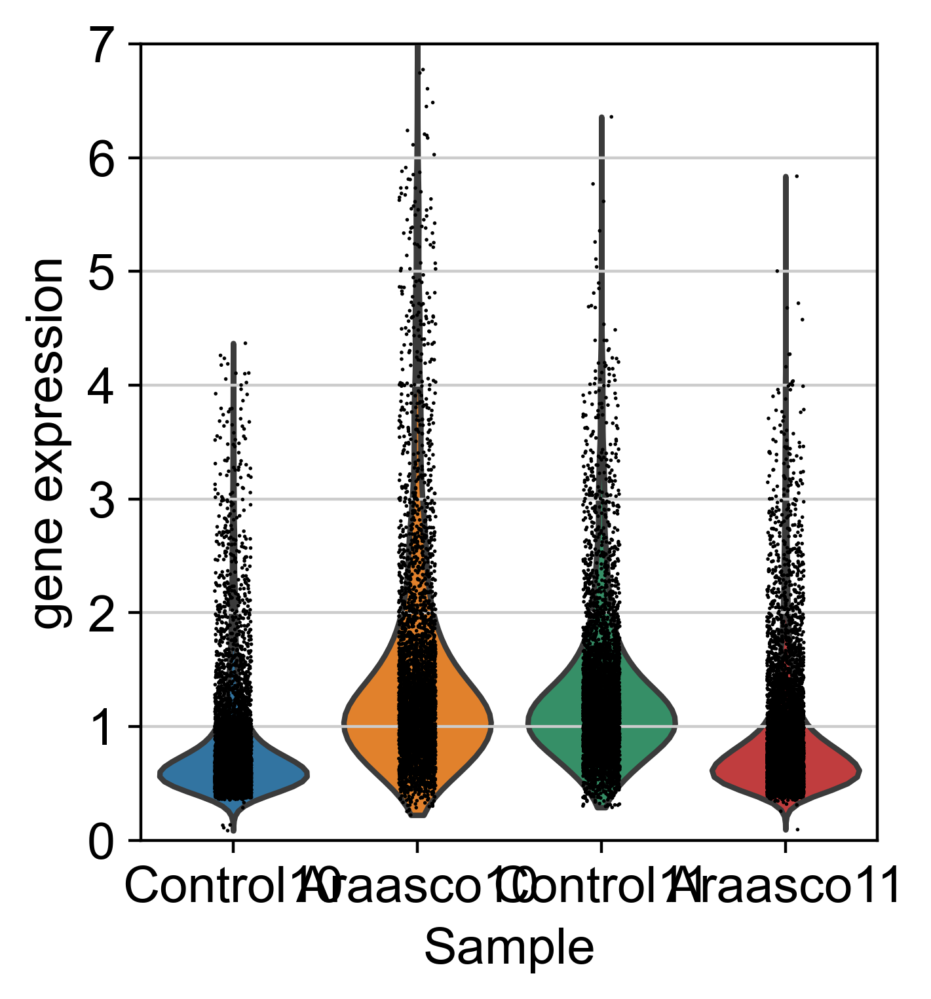

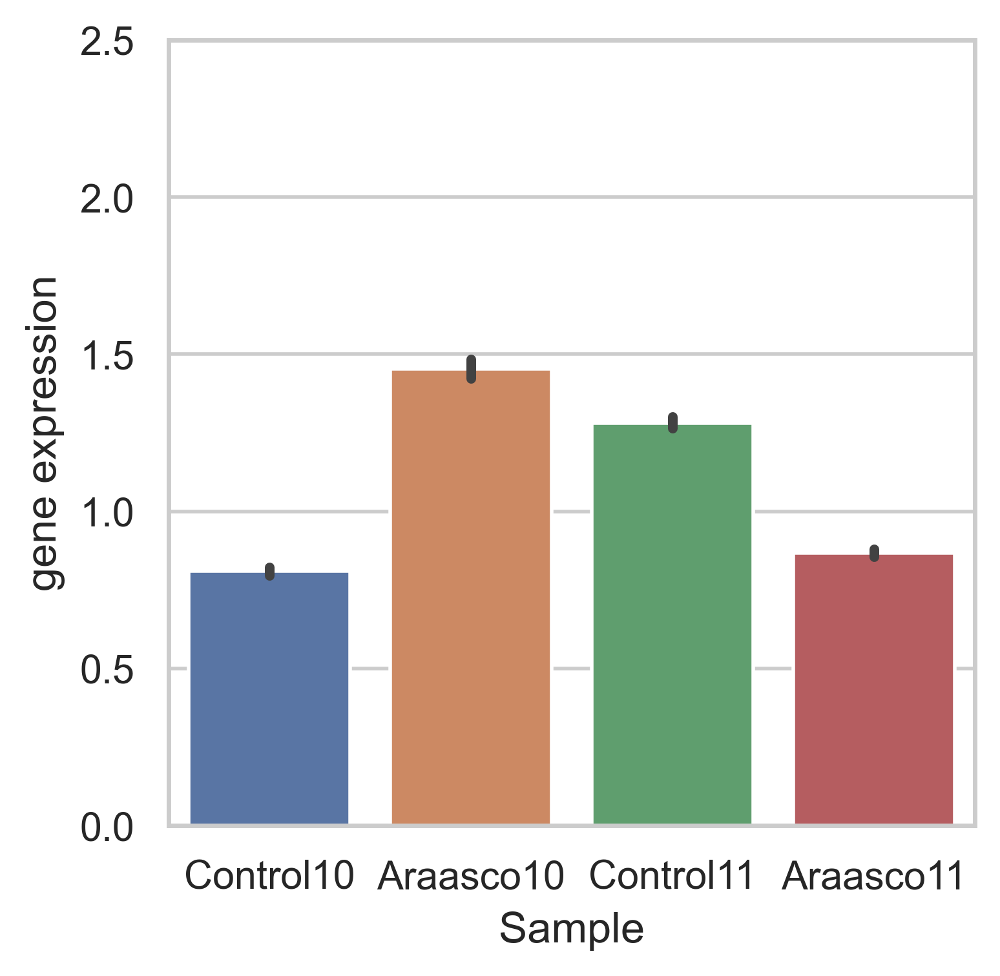

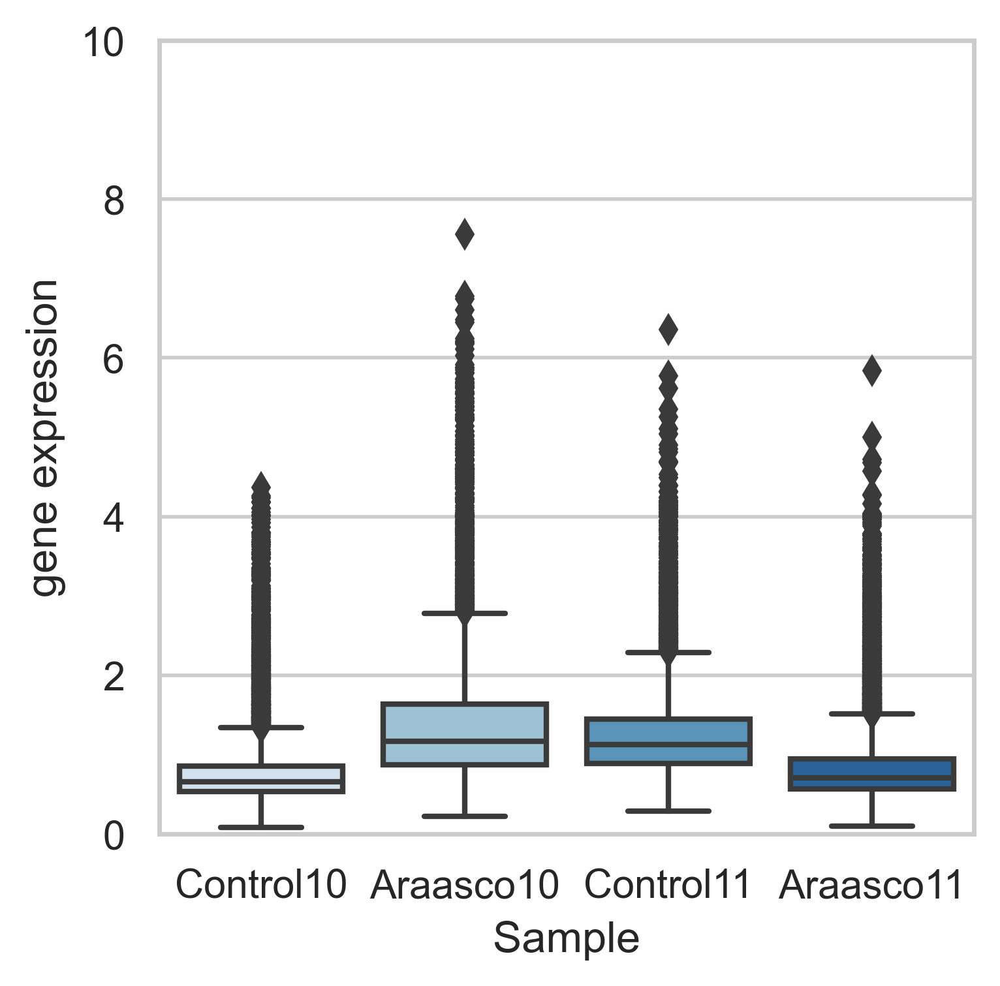

In [29]:
# define gene sets you want to identify
ids_entprox = np.in1d(genedata.var_names, marker_genes['yap'])
ids_entdist = np.in1d(genedata.var_names, marker_genes['yap'])
ids_ent = np.logical_or(ids_entprox, ids_entdist)

#Calculate the mean expression of gene set
genedata.obs['gene expression'] = genedata.X[:,ids_ent].mean(1)

#Plot gene expression
ax = sc.pl.violin(genedata, 'gene expression', groupby='Sample', show=False)
ax = (ax.set(ylim=(0,7)))
plt.show()
# geene expression barplots, error bars represent standard error
sb.set(style="whitegrid")
ax = sb.barplot(x="Sample", y="gene expression", data=genedata.obs, )
ax = (ax.set(ylim=(0,2.5)))
plt.show()

# box plot, diamonds represent outliers
bx = sb.boxplot( x=genedata.obs['Sample'], y=genedata.obs['gene expression'], palette="Blues")
bx = (bx.set(ylim=(0,10)))
plt.show()

In [30]:
# view distribution of cells between samples
adata1.obs['Sample'].value_counts()
genedata.obs['gene expression'].value_counts()

0.650968    13
0.632315    13
0.598275    12
0.638144    12
1.027046    12
            ..
1.332712     1
1.204010     1
1.029611     1
3.555840     1
1.000000     1
Name: gene expression, Length: 11545, dtype: int64

/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
/Users/vyom/opt/miniconda3/envs/scrna/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


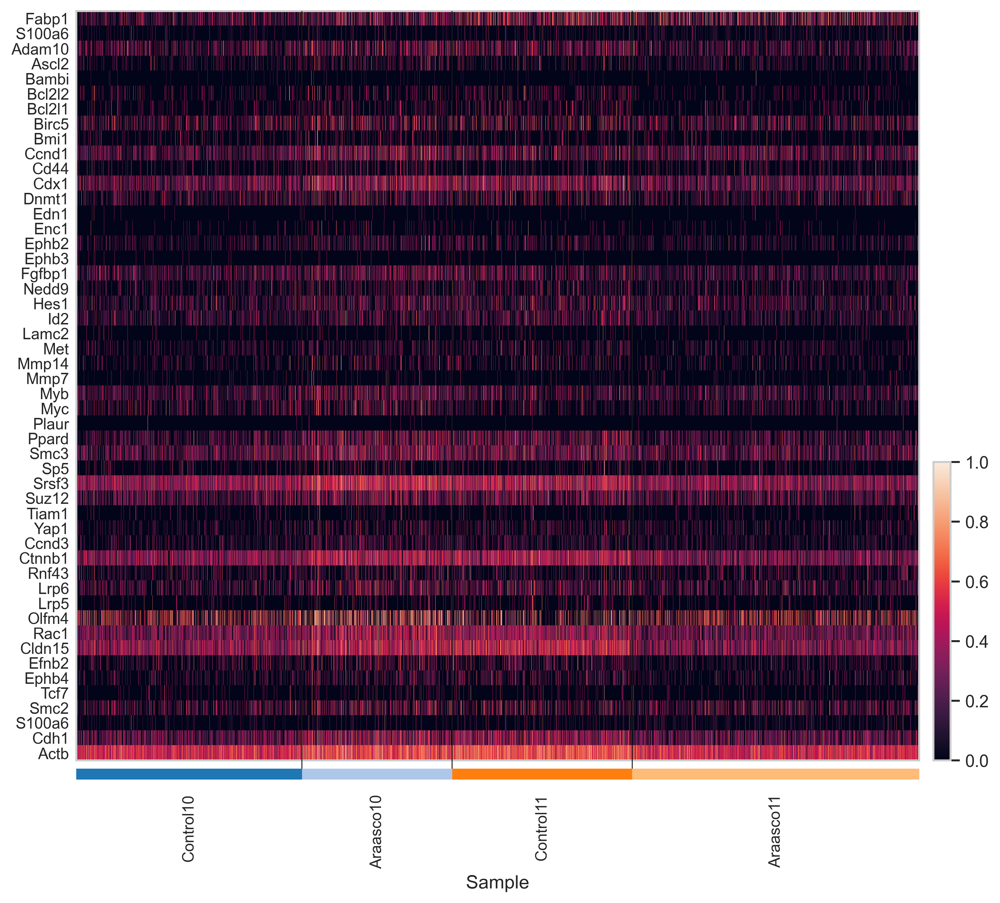

GridSpec(3, 3, height_ratios=[0, 9.0, 0.13], width_ratios=[10, 0, 0.2])

In [31]:
sc.pl.heatmap(adata1, BC_targets, groupby='Sample', log=True, dendrogram=False,var_group_labels= BC_targets, standard_scale='var', swap_axes=True)

# Normilization

After cells are filtered the next step will be normalization. This step is conducted to account for any variability. This is done calculating size factors: estimating cell-specific factors that should be proportional to the true number of molecules(cause some genes have more base pairs than others)

Calculate clusters at a low resolution in order to get an input the size factor estimation.

In [32]:
#Perform a clustering for scran normalization in clusters
adata1_pp = adata1.copy()
sc.pp.normalize_per_cell(adata1_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata1_pp)
sc.pp.pca(adata1_pp, n_comps=15)
sc.pp.neighbors(adata1_pp)
sc.tl.louvain(adata1_pp, key_added='groups', resolution=0.7)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:07)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 15
    computed neighbors (0:00:06)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:03)


Preprocess data by assuming that all size factors are equal

In [33]:
#Preprocess variables for scran normalization
%reload_ext rpy2.ipython
input_groups = adata1_pp.obs['groups']
data_mat = adata1.X.T

Calculate size factors

In [34]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = computeSumFactors(data_mat, clusters=input_groups)


Error in (function (classes, fdef, mtable)  : 
  unable to find an inherited method for function ‘assay’ for signature ‘"dgCMatrix", "character"’


In [40]:
del adata1_pp

Visualize the estimated size factors to show they are non-negative and related to the number of counts and genes per cell as expected.

In [41]:

adata1.obs['size_factors'] = size_factors

sc.pl.scatter(adata1, 'size_factors', 'n_counts')
sc.pl.scatter(adata1, 'size_factors', 'n_genes')

sb.distplot(size_factors, bins=50, kde=False)
plt.show()

NameError: name 'size_factors' is not defined

copy the raw count data in a separate AnnData object. This allows us to use methods downstream that require this data as input.

In [ ]:
#Keep the count data in a counts layer
adata1.layers["counts"] = adata1.X.copy()

Log transform the data. This allows the log transformed data to follow or nearly follow a normal distribution and have reduced skewness

In [ ]:
#Normalize adata 
adata1.X /= adata1.obs['size_factors'].values[:,None]
sc.pp.log1p(adata1)

In [ ]:
del adata1.layers['counts']

In [ ]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
adata1.raw = adata1

In [ ]:
# ComBat batch correction
sc.pp.combat(adata1, key='Sample')

extract highly variable genes (HVGs) to further reduce the dimensionality of the dataset and include only the most informative genes. 

In [ ]:
sc.pp.highly_variable_genes(adata1, flavor='cell_ranger', n_top_genes=16000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata1.var['highly_variable'])))

In [ ]:
sc.pl.highly_variable_genes(adata1)

# Visualization, clustering, sub clustering, marker genes & cluster annotation

The next step is visualizing. Visualizing scRNA-seq data is the process of projecting a high-dimensional matrix of cells and genes into a few coordinates such that every cell is meaningfully represented in a two-dimensional graph. Visualization will ease the computational burdan of downstream analysis.

In [ ]:
# Calculate the visualizations
sc.pp.pca(adata1, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata1)
sc.tl.umap(adata1)
sc.tl.diffmap(adata1)

Below multiple visulization methods are dispayed. However for the remainder of the analysis the Umap method will be used. This is because in a Umap visulization data points are spread out on the plot showing several clusters
and connections between clusters can be readily identified


In [ ]:
sc.pl.pca_scatter(adata1, color='n_counts')
sc.pl.umap(adata1, color='n_counts')
sc.pl.diffmap(adata1, color='n_counts', components=['1,2','1,3'])

To understand the data, we must identify cell types and states present. This can be done by clustering the data. I perform modularity optimization by Louvain community detection on the k-nearest-neighbour graph of cells. Clustering is performed on the highly variable gene data, dimensionality reduced by PCA, and embedded into a KNN graph.

In [ ]:
sc.tl.louvain(adata1, resolution=0.35, key_added='louvain_r0.5', random_state=10) #33

In [ ]:
adata1.obs['louvain_r0.5'].value_counts()

Visualize the clustering and how this is reflected by different technical covariates

In [ ]:
sc.pl.umap(adata1, color=['log_counts', 'n_counts'])
sc.pl.umap(adata1, color=['sample'])
sc.pl.umap(adata1, color=['louvain_r0.5'], legend_loc='on data')

In [ ]:
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [ ]:
marker_genes['Stem'] = ['Lgr5', 'Ascl2', 'Slc12a2', 'Axin2', 'Olfm4', 'Gkn3']
marker_genes['Revival Stem'] = ['S100a6',	'Clu',	'Ly6a',	'S100a11',	'Ly6d',	'Sprr2a3',	'Mif',	'Krt19',	'Krt7',	'Npm1',	'Krt18',	'Rps12-ps3',	'Fxyd3',	'Xcl1',	'Anxa2',	'Ccnd1',	'Ncl',	'Ccnd2',	'Cd44',	'Ptma',	'Anxa3',	'Lmna',	'Ranbp1',	'Rplp0',	'Rpl29',	'Nme1',	'Ran',	'Gm10073',	'Rpl35',	'Dynll1',	'Sprr1a',	'Rps2',	'Rps12',	'Anxa1',	'Rps27l',	'Erh',	'Gm10076',	'Rplp1',	'Pglyrp1',	'Rps28',	'Nhp2',	'Snrpg',	'Rps26',	'Gm8730',	'Sat1',	'Eif2s2',	'Wdr89',	'Hsp90ab1',	'Rpl41',	'Rpl27']
marker_genes['Reserve Stem'] = ["Bmi1","Lrig1","Hopx","Mex3a","Tert"]
marker_genes['Enterocyte (Proximal)'] = ['Gsta1','Rbp2','Adh6a','Apoa4','Reg3a','Creb3l3','Cyp3a13','Cyp2d26','Ms4a10','Ace','Aldh1a1','Rdh7','H2-Q2', 'Hsd17b6','Gstm3','Gda','Apoc3','Gpd1','Fabp1','Slc5a1','Mme','Cox7a1','Gsta4','Lct','Khk','Mttp','Xdh','Sult1b1', 'Treh','Lpgat1','Dhrs1','Cyp2c66','Ephx2','Cyp2c65','Cyp3a25','Slc2a2','Ugdh','Gstm6','Retsat','Ppap2a','Acsl5', 'Cyb5r3','Cyb5b','Ckmt1','Aldob','Ckb','Scp2','Prap1']
marker_genes['Enterocyte (Distal)'] = ['Tmigd1','Fabp6','Slc51b','Slc51a','Mep1a','Fam151a','Naaladl1','Slc34a2','Plb1','Nudt4','Dpep1','Pmp22','Xpnpep2','Muc3','Neu1','Clec2h','Phgr1','2200002D01Rik','Prss30','Cubn','Plec','Fgf15','Crip1','Krt20','Dhcr24','Myo15b','Amn','Enpep','Anpep','Slc7a9','Ocm','Anxa2','Aoc1','Ceacam20','Arf6','Abcb1a','Xpnpep1','Vnn1','Cndp2','Nostrin','Slc13a1','Aspa','Maf','Myh14']
marker_genes['Goblet'] = ['Agr2', 'Fcgbp', 'Tff3', 'Clca1', 'Zg16', 'Tpsg1', 'Muc2', 'Galnt12', 'Atoh1', 'Rep15', 'S100a6', 'Pdia5', 'Klk1', 'Pla2g10', 'Spdef', 'Lrrc26', 'Ccl9', 'Bace2', 'Bcas1', 'Slc12a8', 'Smim14', 'Tspan13', 'Txndc5', 'Creb3l4', 'C1galt1c1', 'Creb3l1', 'Qsox1', 'Guca2a', 'Scin', 'Ern2', 'AW112010', 'Fkbp11', 'Capn9', 'Stard3nl', 'Slc50a1', 'Sdf2l1', 'Hgfa', 'Galnt7', 'Hpd', 'Ttc39a', 'Tmed3', 'Pdia6', 'Uap1', 'Gcnt3', 'Tnfaip8', 'Dnajc10', 'Ergic1', 'Tsta3', 'Kdelr3', 'Foxa3', 'Tpd52', 'Tmed9', 'Spink4', 'Nans', 'Cmtm7', 'Creld2', 'Tm9sf3', 'Wars', 'Smim6', 'Manf', 'Oit1', 'Tram1', 'Kdelr2', 'Xbp1', 'Serp1', 'Vimp', 'Guk1', 'Sh3bgrl3', 'Cmpk1', 'Tmsb10', 'Dap', 'Ostc', 'Ssr4', 'Sec61b', 'Pdia3', 'Gale', 'Klf4', 'Krtcap2', 'Arf4', 'Sep15', 'Ssr2', 'Ramp1', 'Calr', 'Ddost']
marker_genes['Paneth'] = ['Gm15284', 'AY761184', 'Defa17', 'Gm14851', 'Defa22', 'Defa-rs1', 'Defa3', 'Defa24', 'Defa26', 'Defa21', 'Lyz1', 'Gm15292', 'Mptx2', 'Ang4']
marker_genes['Enteroendocrine'] = ['Chgb', 'Gfra3', 'Cck', 'Vwa5b2', 'Neurod1', 'Fev', 'Aplp1', 'Scgn', 'Neurog3', 'Resp18', 'Trp53i11', 'Bex2', 'Rph3al', 'Scg5', 'Pcsk1', 'Isl1', 'Maged1', 'Fabp5', 'Celf3', 'Pcsk1n', 'Fam183b', 'Prnp', 'Tac1', 'Gpx3', 'Cplx2', 'Nkx2-2', 'Olfm1', 'Vim', 'Rimbp2', 'Anxa6', 'Scg3', 'Ngfrap1', 'Insm1', 'Gng4', 'Pax6', 'Cnot6l', 'Cacna2d1', 'Tox3', 'Slc39a2', 'Riiad1']
marker_genes['Tuft'] = ['Alox5ap', 'Lrmp', 'Hck', 'Avil', 'Rgs13', 'Ltc4s', 'Trpm5', 'Dclk1', 'Spib', 'Fyb', 'Ptpn6', 'Matk', 'Snrnp25', 'Sh2d7', 'Ly6g6f', 'Kctd12', '1810046K07Rik', 'Hpgds', 'Tuba1a', 'Pik3r5', 'Vav1', 'Tspan6', 'Skap2', 'Pygl', 'Ccdc109b', 'Ccdc28b', 'Plcg2', 'Ly6g6d', 'Alox5', 'Pou2f3', 'Gng13', 'Bmx', 'Ptpn18', 'Nebl', 'Limd2', 'Pea15a', 'Tmem176a', 'Smpx', 'Itpr2', 'Il13ra1', 'Siglecf', 'Ffar3', 'Rac2', 'Hmx2', 'Bpgm', 'Inpp5j', 'Ptgs1', 'Aldh2', 'Pik3cg', 'Cd24a', 'Ethe1', 'Inpp5d', 'Krt23', 'Gprc5c', 'Reep5', 'Csk', 'Bcl2l14', 'Tmem141', 'Coprs', 'Tmem176b', '1110007C09Rik', 'Ildr1', 'Galk1', 'Zfp428', 'Rgs2', 'Inpp5b', 'Gnai2', 'Pla2g4a', 'Acot7', 'Rbm38', 'Gga2', 'Myo1b', 'Adh1', 'Bub3', 'Sec14l1', 'Asah1', 'Ppp3ca', 'Agt', 'Gimap1', 'Krt18', 'Pim3', '2210016L21Rik', 'Tmem9', 'Lima1', 'Fam221a', 'Nt5c3', 'Atp2a3', 'Mlip', 'Vdac3', 'Ccdc23', 'Tmem45b', 'Cd47', 'Lect2', 'Pla2g16', 'Mocs2', 'Arpc5', 'Ndufaf3']
marker_genes['TA'] = ["Tubb5","Hmgb2","Stmn1","H2afz1","Tuba1b","Hmgb11","Hmgn22","Ptma1","Kiaa0101","Tk1","Cenpw","Tyms","Ranbp11","Idh21","Ran1","Dtymk","Nucks11","Dut1","Cks1b"]
marker_genes['EP(early)'] = ['Slc16a1']
marker_genes['EP(late)'] = [ 'Ccnb1','Cdc20','Cenpa','Cdkn3','Cdc25c','Ccnb2','Kif22','Ube2c','Sapcd2','Rbp7','Ccna2','Aurka','Cdkn2d','Kif23','Nek2','Birc5','Plk1']
marker_genes['EP'] = ['Slc16a1', 'Ccnb1','Cdc20','Cenpa','Cdkn3','Cdc25c','Ccnb2','Kif22','Ube2c','Sapcd2','Rbp7','Ccna2','Aurka','Cdkn2d','Kif23','Nek2','Birc5','Plk1']
marker_genes['macrophage'] = ['Cx3cr1', 'Cd64', 'Cd11b']
marker_genes['CD8 t cell'] = ['Cd44', 'Cd49a','Cd103','Cd69']


In [ ]:
# Check expression of  markers
#Collate all markers and get the gene IDs in the data set
ids_entprox = np.in1d(adata1.var_names, marker_genes['Enteroendocrine'])
ids_entdist = np.in1d(adata1.var_names, marker_genes['Enteroendocrine'])
ids_ent = np.logical_or(ids_entprox, ids_entdist)

#Calculate the mean expression of enterocyte markers
adata1.obs['gene expression'] = adata1.X[:,ids_ent].mean(1)

#Plot enterocyte expression
sc.pl.violin(adata1, 'gene expression', groupby='sample')
sc.pl.violin(adata1, 'gene expression', groupby='louvain_r0.5')
sc.pl.umap(adata1, color='gene expression', color_map=mymap)

sb.set(style="whitegrid")
ax = sb.barplot(x="Sample", y="gene expression", data=adata1.obs)
ax = (ax.set(ylim=(0,10)))

plt.show()

In [55]:
adata1.rename_categories('louvain_r0.5', ['Enterocyte (Proximal)', 'TA', 'Stem', 'EP','Paneth', 'Goblet', 'Tuft', 'Enterocyte (Distal)', 'CD8+ intraepithelial cells','Macrophage'])


In [183]:
adata1.obs

,Sample,sample,n_counts,log_counts,n_genes,percent_mito,percent_Rpl,percent_ribo,size_factors,louvain_r0.5,gene expression,dpt_pseudotime
AAACCCACACCCTAAA-1-Control10,Control10,Control,7345.0,8.901775,2659,0.009803,0.095848,0.177400,0.820866,TA,0.075985,0.011462
AAACCCAGTCTGCGCA-1-Control10,Control10,Control,6457.0,8.772920,2598,0.044448,0.094316,0.168499,0.691113,Stem,0.048851,0.011928
AAACCCATCAAGTAAG-1-Control10,Control10,Control,8139.0,9.004422,2692,0.062293,0.075562,0.132694,0.859066,Enterocyte (Proximal),0.021257,0.032367
AAACCCATCCCTTGGT-1-Control10,Control10,Control,6603.0,8.795280,2379,0.081175,0.089959,0.169317,0.676291,EP,0.002412,0.024192
AAACCCATCCGCATAA-1-Control10,Control10,Control,12636.0,9.444305,3740,0.061887,0.081513,0.152817,1.320210,TA,0.035710,0.019054
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCACCGGTG-1-Araasco11,Araasco11,Araasco,5510.0,8.614320,2119,0.059891,0.122686,0.219964,0.590336,EP,0.002051,0.022606
TTTGTTGTCCACCTCA-1-Araasco11,Araasco11,Araasco,5255.0,8.566936,2190,0.085252,0.135871,0.258801,0.441511,Stem,0.063097,0.004473
TTTGTTGTCCATCTAT-1-Araasco11,Araasco11,Araasco,6402.0,8.764366,2165,0.127929,0.061699,0.109809,0.643918,Enterocyte (Proximal),0.002051,0.029389
TTTGTTGTCGGTCTGG-1-Araasco11,Araasco11,Araasco,8045.0,8.992806,2797,0.095463,0.114232,0.212306,0.801926,TA,0.041950,0.009580


In [ ]:
adata1.obs['sample'].value_counts()


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

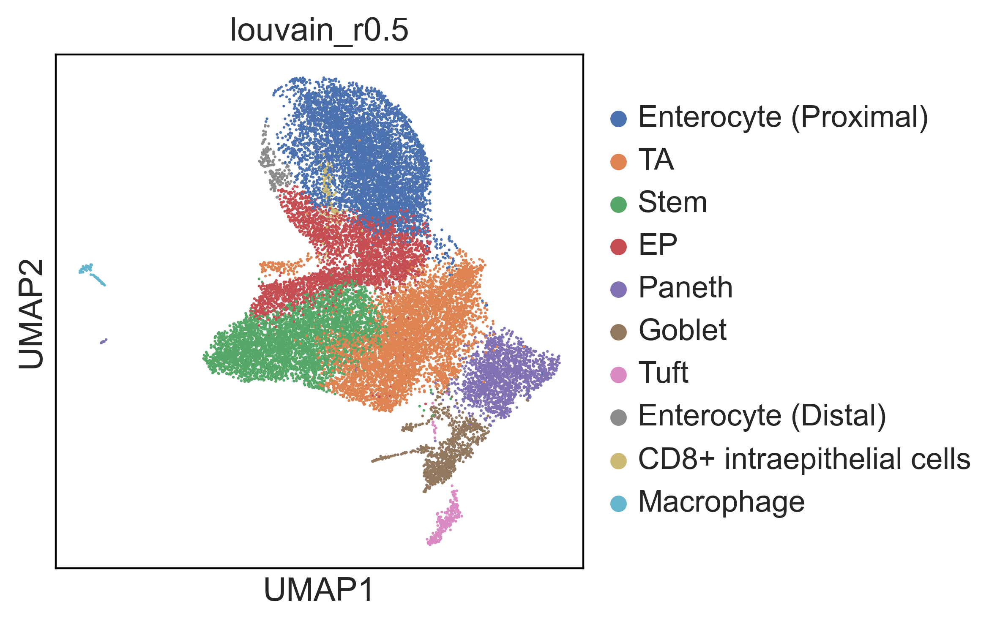

In [182]:
sc.pl.umap(adata1, color='louvain_r0.5', use_raw=False, color_map=mymap)


sample,Araasco,Control
louvain_r0.5,,
Enterocyte (Proximal),2841,3163
TA,3124,2229
Stem,2328,2128
EP,1600,1778
Paneth,938,748
Goblet,481,450
Tuft,124,129
Enterocyte (Distal),103,67
CD8+ intraepithelial cells,67,76


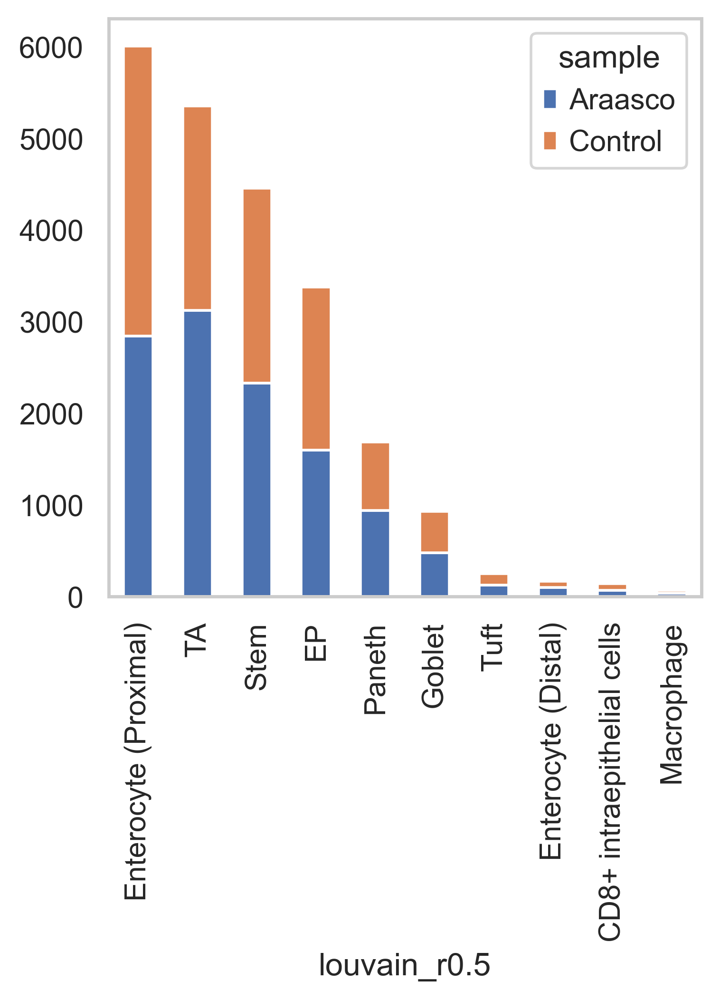

In [60]:
var1 = 'louvain_r0.5'
var2 = 'sample'

df = adata1.obs.loc[:, [var1,var2]]
df_pivot = df.pivot_table(index=var1, columns=var2, aggfunc=len, fill_value=0)
import seaborn as sns
df_pivot
df_pivot.plot(kind='bar', stacked=True, grid=False)

df = adata1.obs.loc[:, [var1,var2]]
df_pivot = df.pivot_table(index=var1, columns=var2, aggfunc=len, fill_value=0)
df_pivot

In [171]:
#Subsetting to relevant clusters
clusters_to_include = [g for g in adata1.obs['louvain_r0.5'].cat.categories if (g.startswith('Stem') or g.startswith('TA') or g.startswith('Ent') or g.startswith('Goblet') or g.startswith('Pan') or g.startswith('EP'))]
adata_ent = adata1[np.isin(adata1.obs['louvain_r0.5'], clusters_to_include),:].copy()

#Subset to highly variable genes
sc.pp.highly_variable_genes(adata_ent, flavor='cell_ranger', n_top_genes=10000, subset=True)


extracting highly variable genes
    the 10000 top genes correspond to a normalized dispersion cutoff of -0.27066779136657715
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


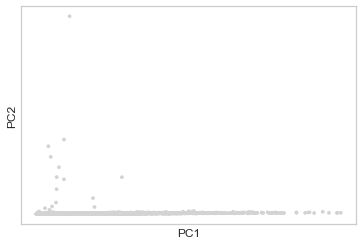

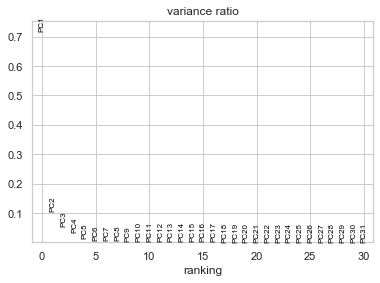

In [97]:
#Recalculating PCA for subset
sc.pp.pca(adata_ent, svd_solver='arpack')
sc.pl.pca(adata_ent)
sc.pl.pca_variance_ratio(adata_ent)

In [98]:
adata_ent.obsm['X_pca'] = adata_ent.obsm['X_pca'][:,0:7]


The first method of this analysis uses the slingshot package in R. The package 'anndata2ri' is responsible for converting the anndata object to a single cell experiment. The graph below displays the trajectory structure if the structure starts with the stem cell cluster and displays the differentiation process.

In [90]:
import rpy2.robjects.numpy2ri
rpy2.robjects.numpy2ri.activate()

The next method for trajectory interface is monocle. Monocle is a more populer form of trajectory analysis as it works very well with multiple trajectory interfaces. Here I used monocle to confirm that the trajectories from slingshot.

In [92]:
#Preprocessing for monocle
adata1.layers["counts"] = adata1.X.copy()
data_mat_mon = adata1.layers['counts'].T
var_mon=adata1.var.copy()
obs_mon=adata1.obs.copy()

In [107]:
%%R -i data_mat_mon -i obs_mon -i var_mon

#Set up the CellDataSet data structure
pd <- AnnotatedDataFrame(data = obs_mon)
fd <- AnnotatedDataFrame(data = var_mon)
colnames(data_mat_mon) <- rownames(pd)
rownames(data_mat_mon) <- rownames(fd)
ie_regions_cds <- newCellDataSet(cellData=data_mat_mon, phenoData=pd, featureData=fd, expressionFamily=negbinomial.size())

#Normalize the count data
ie_regions_cds <- estimateSizeFactors(ie_regions_cds)

#Calculate dispersions to filter for highly variable genes
ie_regions_cds <- estimateDispersions(ie_regions_cds)


#Filter for Stem, EP, TA, and Enterocytes
cell_types = as.character(pData(ie_regions_cds)$louvain_r0.5)
cell_mask = rep(FALSE, length(cell_types))
cells_to_keep = c("Stem", "TA", "Ent","Goblet","Pan")
for (item in cells_to_keep) {cell_mask = cell_mask | startsWith(cell_types, item)}
print("Number of cells after filtering:")
print(sum(cell_mask))
print("")

#Filter highly variable genes from our analysis
hvg_mask = fData(ie_regions_cds)$highly_variable
ie_regions_cds <- ie_regions_cds[hvg_mask, cell_mask]
print("check1")
#Do dimensionality reduction
ie_regions_cds <- reduceDimension(ie_regions_cds, norm_method = 'vstExprs', reduction_method='DDRTree', verbose = F, max_components = 7)
print("check2")
#Run for the first time to get the ordering
ie_regions_cds <- orderCells(ie_regions_cds)
print("check3")
#Find the correct root state the corresponds to the 'Stem' cluster
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$louvain_r0.5)
id = which(colnames(tab1) == 'Stem')
root_name = names(which.max(tab1[,id]))
print("check4")
#Run a second time to get the correct root state that overlaps with Stem cells
ie_regions_cds <- orderCells(ie_regions_cds, root_state=root_name)


[1] "Number of cells after filtering:"
[1] 2779
[1] ""
[1] "check1"
[1] "check2"
[1] "check3"
[1] "check4"


The chart below displays the the linages that diverge from stem cells. Stem cells differentiate into distal enterocytes and then proximal enterocytes.

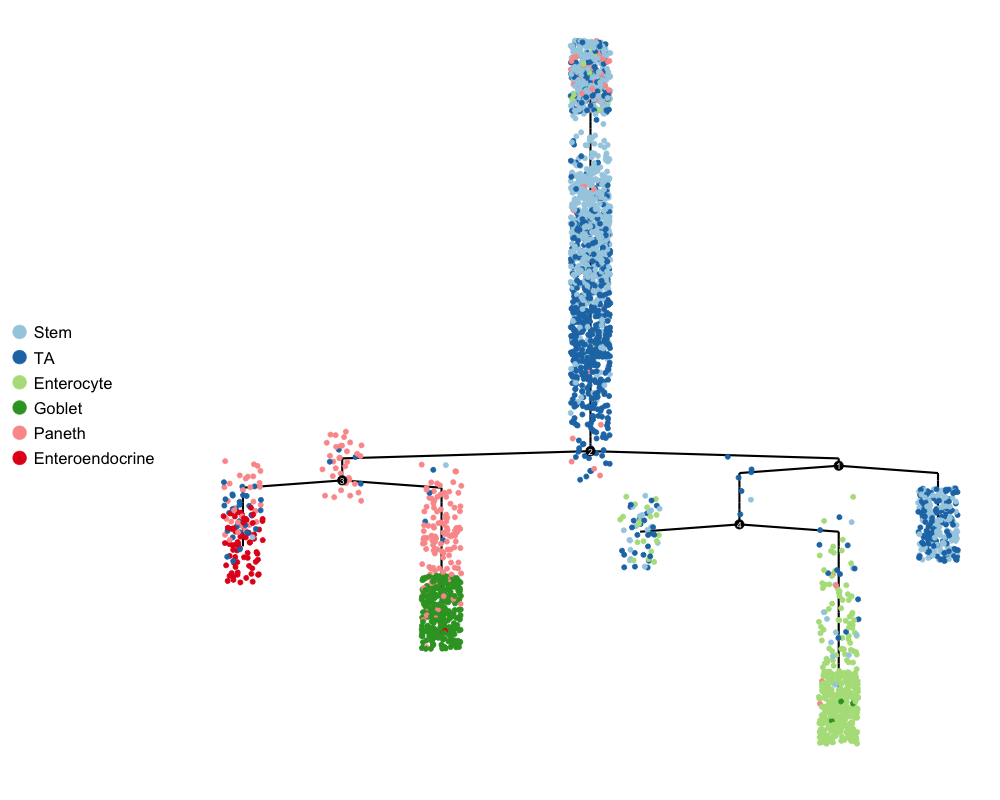

In [108]:
%%R -w 1000 -h 800

#Get a nice colour map
custom_colour_map = brewer.pal(length(unique(pData(ie_regions_cds)$louvain_r0.5)),'Paired')

#Find the correct root state that coresponds to the 'Stem' cluster
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$louvain_r0.5)
id = which(colnames(tab1) == 'Stem')
root_name = names(which.max(tab1[,id]))

# Visualize with our cluster labels
options(repr.plot.width=5, repr.plot.height=4)
plot_complex_cell_trajectory(ie_regions_cds, color_by = 'louvain_r0.5', show_branch_points = T, 
                             cell_size = 2, cell_link_size = 1, root_states = c(root_name)) +
scale_size(range = c(0.2, 0.2)) +
theme(legend.position="left", legend.title=element_blank(), legend.text=element_text(size=rel(1.5))) +
guides(colour = guide_legend(override.aes = list(size=6))) + 
scale_color_manual(values = custom_colour_map)

This chart displays the trajectory as the pseudotime advances

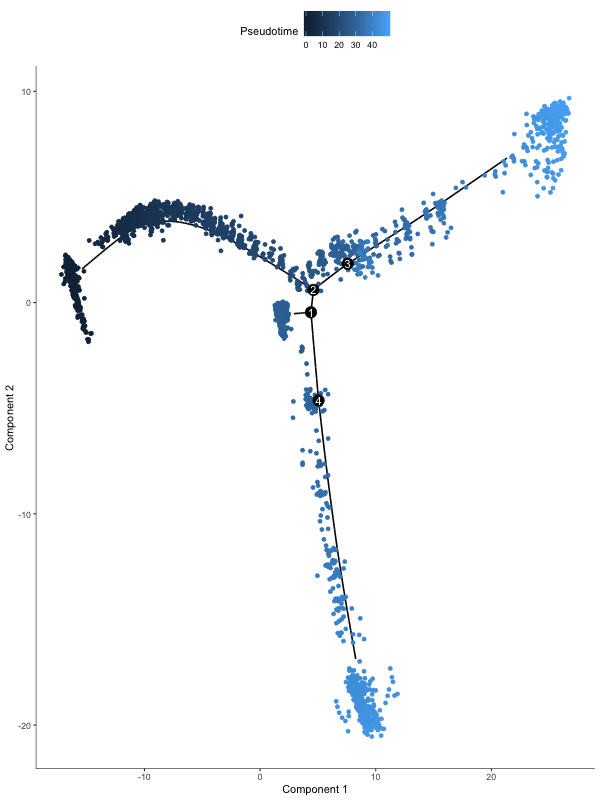

In [109]:
%%R -w 600 -h 800

#Visualize pseudotime found
options(repr.plot.width=5, repr.plot.height=4)
plot_cell_trajectory(ie_regions_cds, color_by="Pseudotime")

Below are the trajectories displayed in the format of a diffusion map. I include Diffusion Pseudotime in the analysis to further support the found trajectories. The benefits of a diffusion map are as follows: shows connections between regions of higher density; very clear trajectories are suggested, but clusters are less clear; each diffusion component extracts heterogeneity in a different part of the data

In [99]:
sc.pp.neighbors(adata_ent)
sc.tl.diffmap(adata_ent)

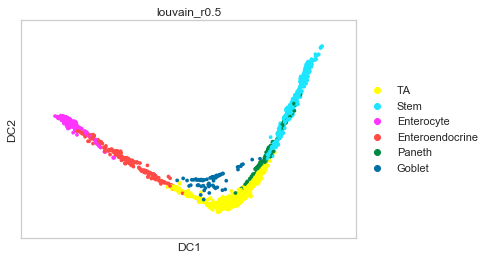

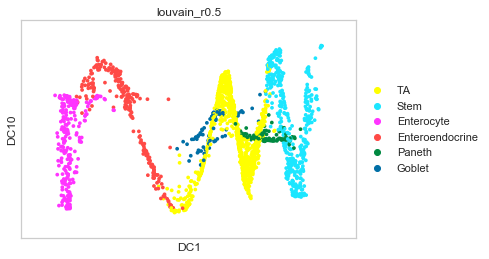

In [104]:
sc.pl.diffmap(adata_ent, components='1,2', color='louvain_r0.5')
sc.pl.diffmap(adata_ent, components='1,10', color='louvain_r0.5')

In [105]:
#Find the stem cell with the highest DC3 value to act as root for the diffusion pseudotime and compute DPT
stem_mask = np.isin(adata_ent.obs['Cell Type'], 'Stem')
max_stem_id = np.argmin(adata_ent.obsm['X_diffmap'][stem_mask,3])
root_id = np.arange(len(stem_mask))[stem_mask][max_stem_id]
adata_ent.uns['iroot'] = root_id

#Compute dpt
sc.tl.dpt(adata_ent)

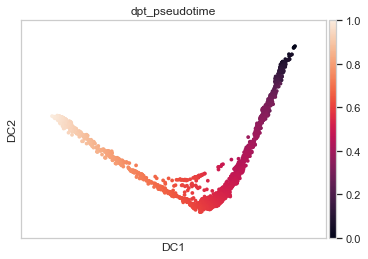

In [106]:
#Visualize pseudotime over differentiation
sc.pl.diffmap(adata_ent, components='1,2', color='dpt_pseudotime')

    Graph has more than a single connected component. To restrict to this component, pass `single_component=True`.
--> added 'pos', the PAGA positions (adata.uns['paga'])


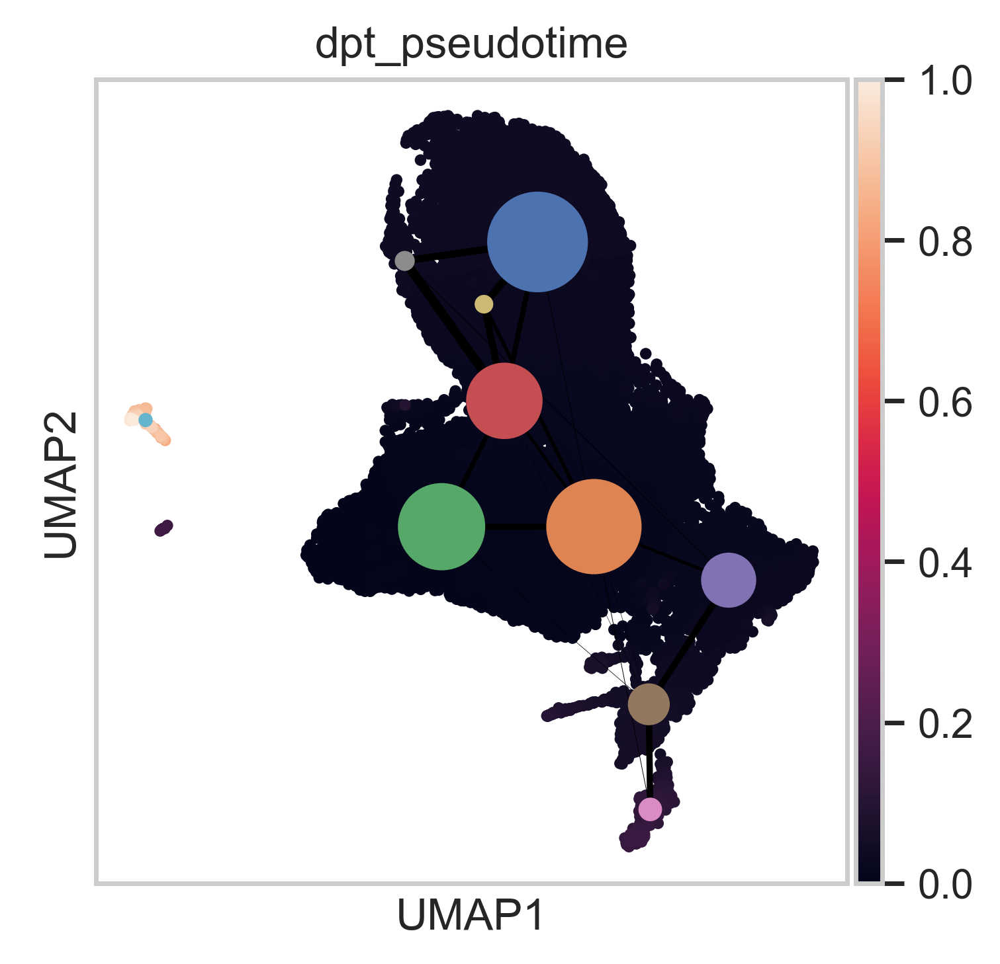

In [72]:
fig1, ax1 = plt.subplots()
sc.pl.umap(adata1, size=40, ax=ax1, color='dpt_pseudotime', legend_loc='on data', show=False)
sc.pl.paga(adata1, pos=adata1.uns['paga']['pos'], show=False, node_size_scale=1, node_size_power=1, ax=ax1, text_kwds={'alpha':0})
#plt.savefig('./figures/umap_paga_overlay_gut.pdf', dpi=300, format='pdf')
plt.show()

In [98]:
genedata.obs['louvain_r0.5'] = adata1.obs['louvain_r0.5']
genedata.obs['sample'] = adata1.obs['sample']

In [99]:
sc.tl.rank_genes_groups(genedata, groupby='louvain_r0.5')
allmarkers = pd.DataFrame(genedata.uns['rank_genes_groups']['names'])

ranking genes
    consider 'louvain_r0.5' groups:
    with sizes: [6004 5353 4456 3378 1686  931  253  170  143   71]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


In [134]:
sc.tl.rank_genes_groups(genedata, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )


ranking genes
    consider 'sample' groups:
    with sizes: [11643 10802]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:24)


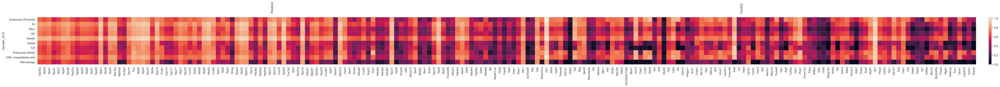

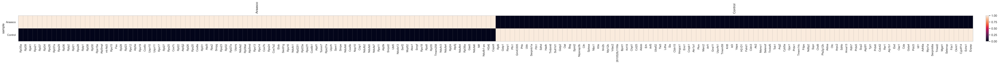

In [135]:
sc.pl.rank_genes_groups_matrixplot(genedata, n_genes=100,  key = "all", groupby = 'louvain_r0.5', dendrogram=False)
sc.pl.rank_genes_groups_matrixplot(genedata, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

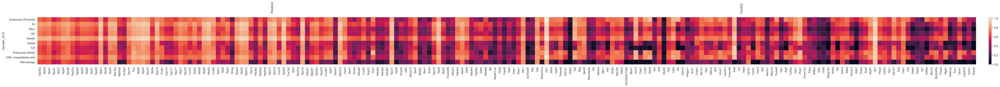

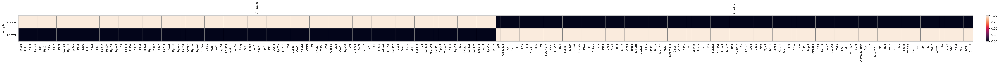

In [124]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Stem'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')


ranking genes
    consider 'sample' groups:
    with sizes: [3124 2229]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


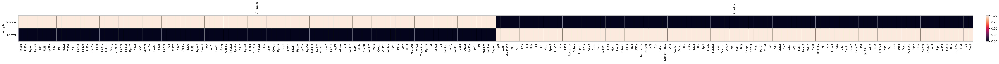

In [125]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('TA'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [938 748]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


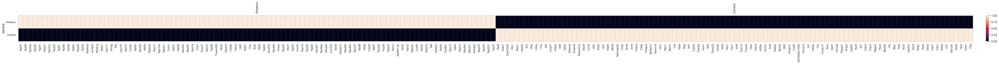

In [126]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Paneth'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [124 129]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


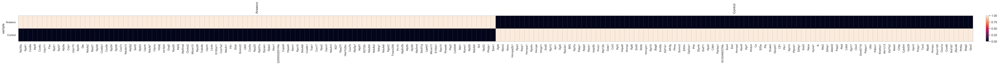

In [127]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Tuft'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [481 450]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


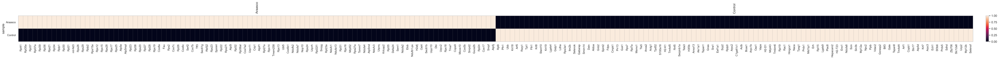

In [128]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Goblet'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [1600 1778]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


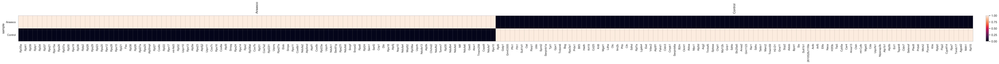

In [129]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('EP'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [2944 3230]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


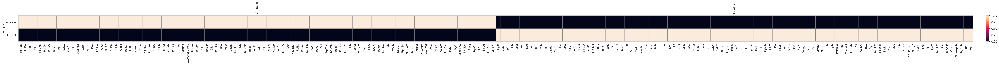

In [130]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Ent'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [67 76]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


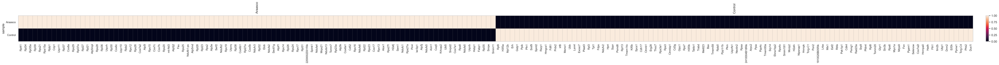

In [131]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('CD'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')

ranking genes
    consider 'sample' groups:
    with sizes: [37 34]
    finished: added to `.uns['all']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


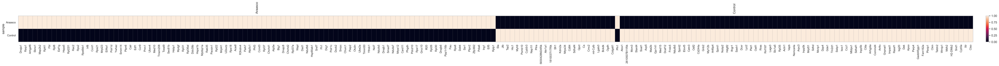

In [132]:
clusters_to_include = [g for g in genedata.obs['louvain_r0.5'].cat.categories if (g.startswith('Macrophage'))]
adata_ent = genedata[np.isin(genedata.obs['louvain_r0.5'], clusters_to_include),:].copy()
sc.tl.rank_genes_groups(adata_ent, groupby='sample', method = "wilcoxon", use_raw=False, key_added = "all", rankby_abs = False )
sc.pl.rank_genes_groups_matrixplot(adata_ent, n_genes=100,  key = "all", groupby = 'sample', dendrogram=False, standard_scale='var')